# Programming Project #1: Hybrid Images

## CS445: Computational Photography - Spring 2020

### Part I: Hybrid Images

#### Import Libraries, Hybrid Image Function Definition, Sample Image Testing

In [1]:
import cv2

import numpy as np
from matplotlib.colors import LogNorm
from scipy import signal

import utils

In [2]:
%matplotlib notebook
import matplotlib.pyplot as plt

In [3]:
im1_file = './Nutmeg.jpg'
im2_file = './DerekPicture.jpg'

im1 = cv2.imread(im1_file, cv2.IMREAD_GRAYSCALE)
im2 = cv2.imread(im2_file, cv2.IMREAD_GRAYSCALE)

<IPython.core.display.Javascript object>


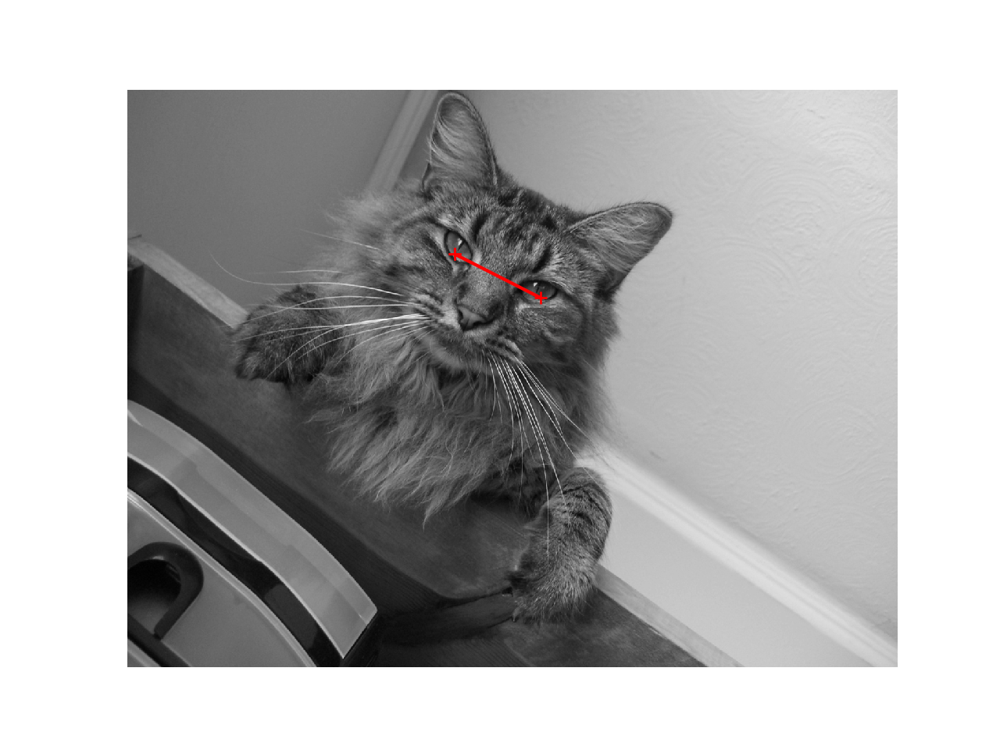

In [4]:
pts_im1 = utils.prompt_eye_selection(im1)

<IPython.core.display.Javascript object>


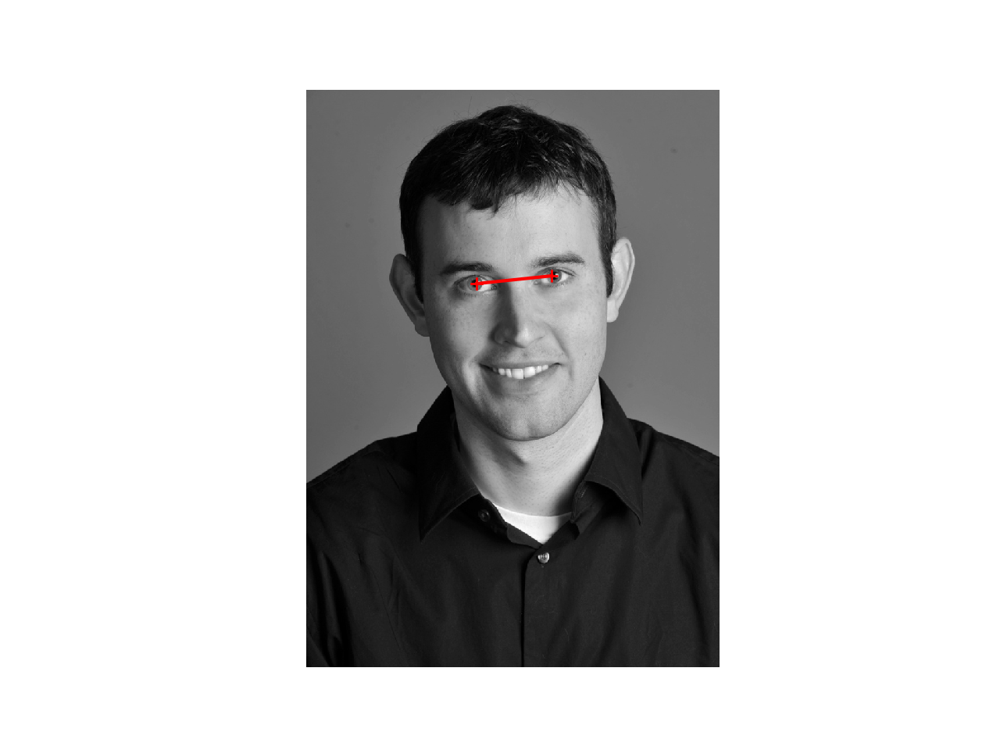

In [5]:
pts_im2 = utils.prompt_eye_selection(im2)

In [6]:
im1, im2 = utils.align_images(im1_file, im2_file,pts_im1,pts_im2,save_images=False)

In [7]:
# convert to grayscale
im1 = cv2.cvtColor(im1, cv2.COLOR_BGR2GRAY) / 255.0
im2 = cv2.cvtColor(im2, cv2.COLOR_BGR2GRAY) / 255.0

<IPython.core.display.Javascript object>


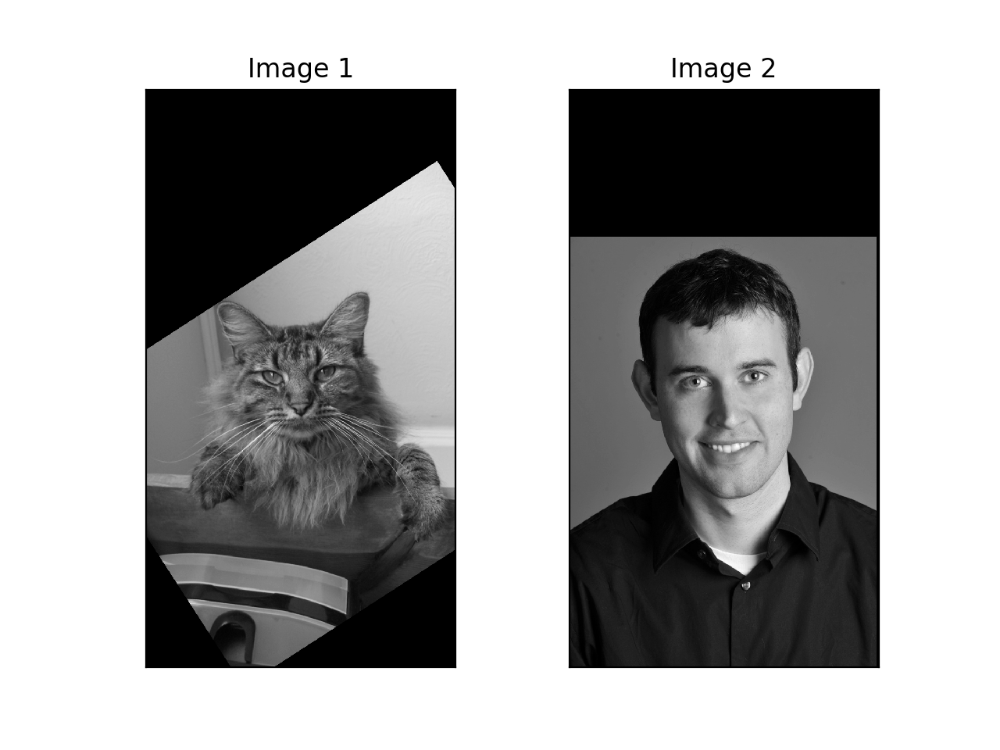

In [8]:
#Images sanity check
fig, axes = plt.subplots(1, 2)
axes[0].imshow(im1,cmap='gray')
axes[0].set_title('Image 1'), axes[0].set_xticks([]), axes[0].set_yticks([])
axes[1].imshow(im2,cmap='gray')
axes[1].set_title('Image 2'), axes[1].set_xticks([]), axes[1].set_yticks([]);

In [9]:
# Low-Pass Filter: Standard 2D Gaussian Filter
# -> Sample Functions and Implementations available for pseudocoding
# cv2.GaussianBlur()
# def matlab_style_gauss2D(shape=(3,3),sigma=0.5):
#     """
#     2D gaussian mask - should give the same result as MATLAB's
#     fspecial('gaussian',[shape],[sigma])
#     """
#     m,n = [(ss-1.)/2. for ss in shape]
#     y,x = np.ogrid[-m:m+1,-n:n+1]
#     h = np.exp( -(x*x + y*y) / (2.*sigma*sigma) )
#     h[ h < np.finfo(h.dtype).eps*h.max() ] = 0
#     sumh = h.sum()
#     if sumh != 0:
#         h /= sumh
#     return h
# scipy.ndimage.filters.gaussian_filter

In [10]:
# High-Pass Filter: Impulse filter - minus the Gaussian Filter
# which is Original - Gaussian-Filtered Image -> Original - Low-Pass
# Usage: cv2.subtract(img1,img2)

In [11]:
def hybridImage(im1, im2, cutoff_low, cutoff_high):
    '''
    Inputs:
        im1:    RGB (height x width x 3) or a grayscale (height x width) image
                as a numpy array.
        im2:    RGB (height x width x 3) or a grayscale (height x width) image
                as a numpy array.
        cutoff_low: standard deviation for the low-pass filter
        cutoff_high: standard deviation for the high-pass filter
        
    Output:
        Return the combination of both images, one filtered with a low-pass filter
        and the other with a high-pass filter.
    '''
    lowPassImage = cv2.GaussianBlur(im1, (35,35), cutoff_low)
    lowPassImage2 = cv2.GaussianBlur(im2, (35,35), cutoff_high)
    highPassImage = cv2.subtract(im2, lowPassImage2)
    hybridImage = cv2.add(lowPassImage, highPassImage)
    return hybridImage

In [12]:
arbitrary_value = 20  # you should choose meaningful values; you might want to set to a fraction of image size
cutoff_low = arbitrary_value
cutoff_high = arbitrary_value

im_hybrid = hybridImage(im2, im1, cutoff_low, cutoff_high)
# cv2.imshow("image", im_hybrid)

<IPython.core.display.Javascript object>


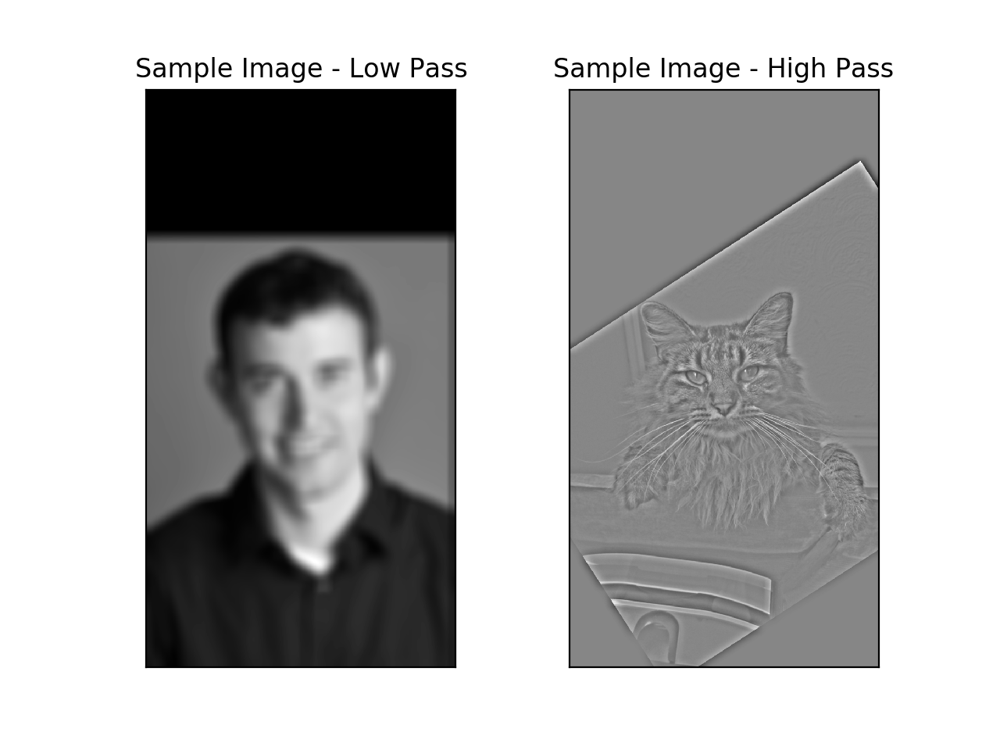

In [13]:
# Image Sanity Check
lowPassImage = cv2.GaussianBlur(im2, (35,35), cutoff_low)
lowPassImage2 = cv2.GaussianBlur(im1, (35,35), cutoff_high)
highPassImage = cv2.subtract(im1, lowPassImage2)
fig, axes = plt.subplots(1, 2)
axes[0].imshow(lowPassImage,cmap='gray')
axes[0].set_title('Sample Image - Low Pass'), axes[0].set_xticks([]), axes[0].set_yticks([])
axes[1].imshow(highPassImage,cmap='gray')
axes[1].set_title('Sample Image - High Pass'), axes[1].set_xticks([]), axes[1].set_yticks([]);

<IPython.core.display.Javascript object>


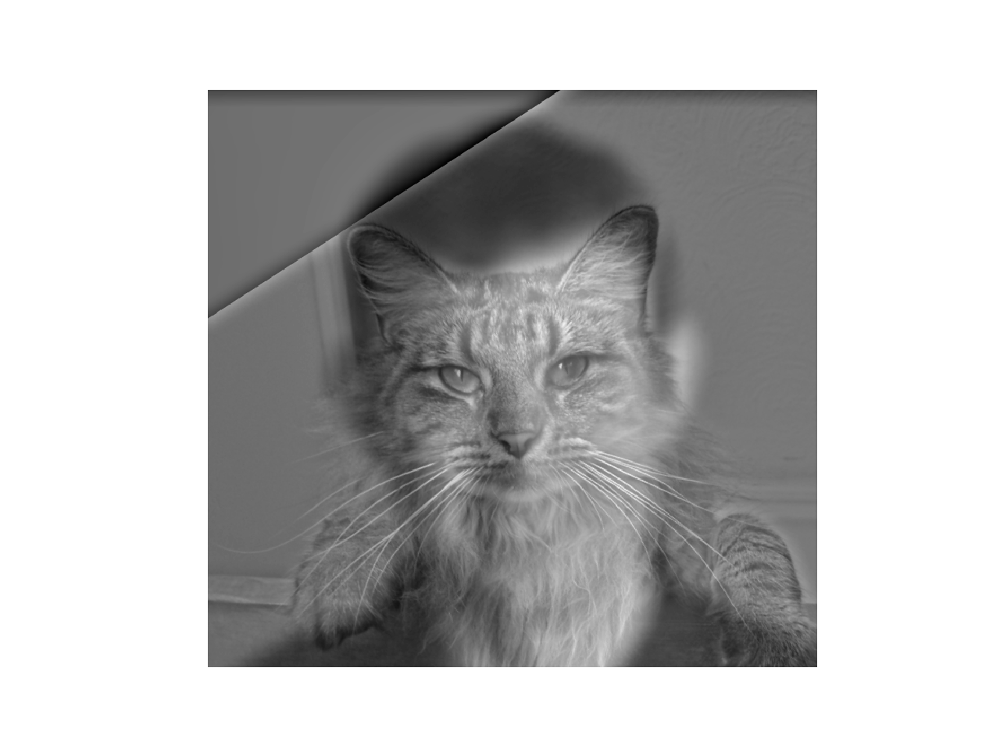

In [14]:
# Optional: Select top left corner and bottom right corner to crop image
# the function returns dictionary of 
# {
#   'cropped_image': np.ndarray of shape H x W
#   'crop_bound': np.ndarray of shape 2x2
# }
cropped_object = utils.interactive_crop(im_hybrid)

In [15]:
# cv2.imshow("image", cropped_object)

#### User Images

#### Hybrid Image 1: Successful

In [16]:
im1_file = './MonaLisa.jpg'
im2_file = './BatManDrawing.jpg'

im1 = cv2.imread(im1_file, cv2.IMREAD_GRAYSCALE)
im2 = cv2.imread(im2_file, cv2.IMREAD_GRAYSCALE)

<IPython.core.display.Javascript object>


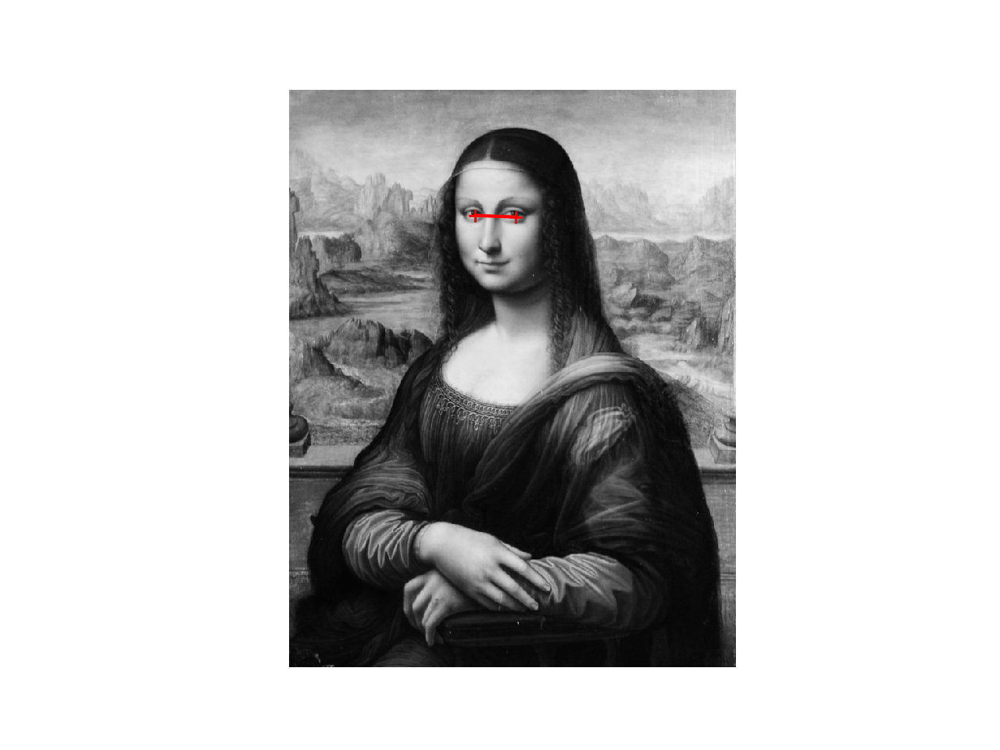

In [17]:
pts_im1 = utils.prompt_eye_selection(im1)

<IPython.core.display.Javascript object>


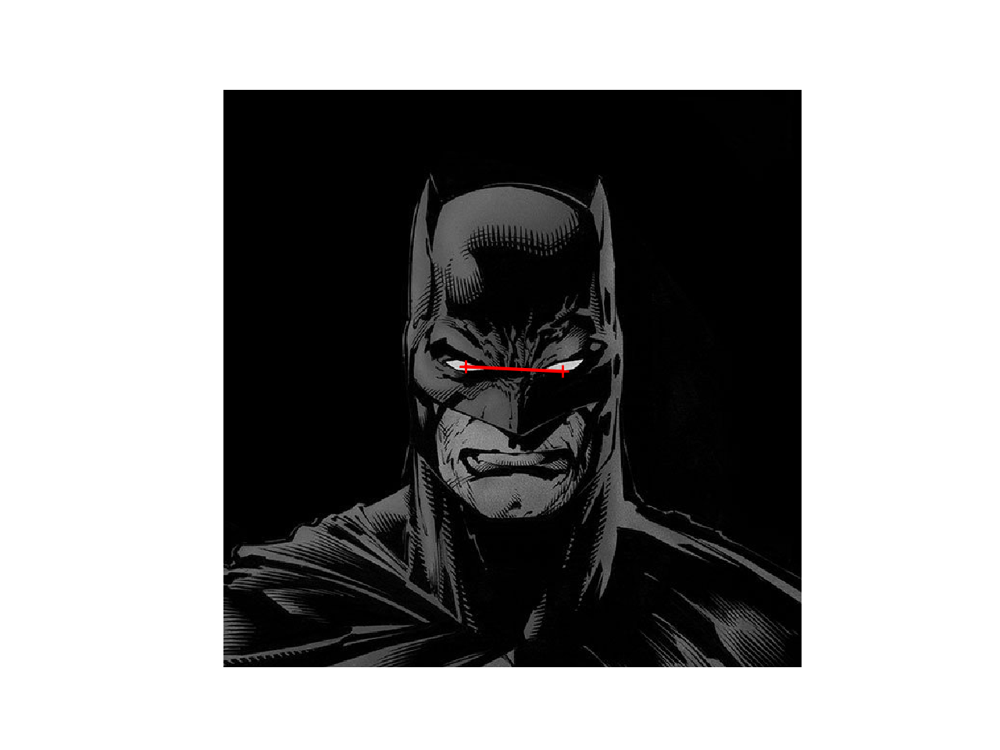

In [18]:
pts_im2 = utils.prompt_eye_selection(im2)

In [19]:
im1, im2 = utils.align_images(im1_file, im2_file,pts_im1,pts_im2,save_images=False)
# convert to grayscale
im1 = cv2.cvtColor(im1, cv2.COLOR_BGR2GRAY) / 255.0
im2 = cv2.cvtColor(im2, cv2.COLOR_BGR2GRAY) / 255.0

<IPython.core.display.Javascript object>


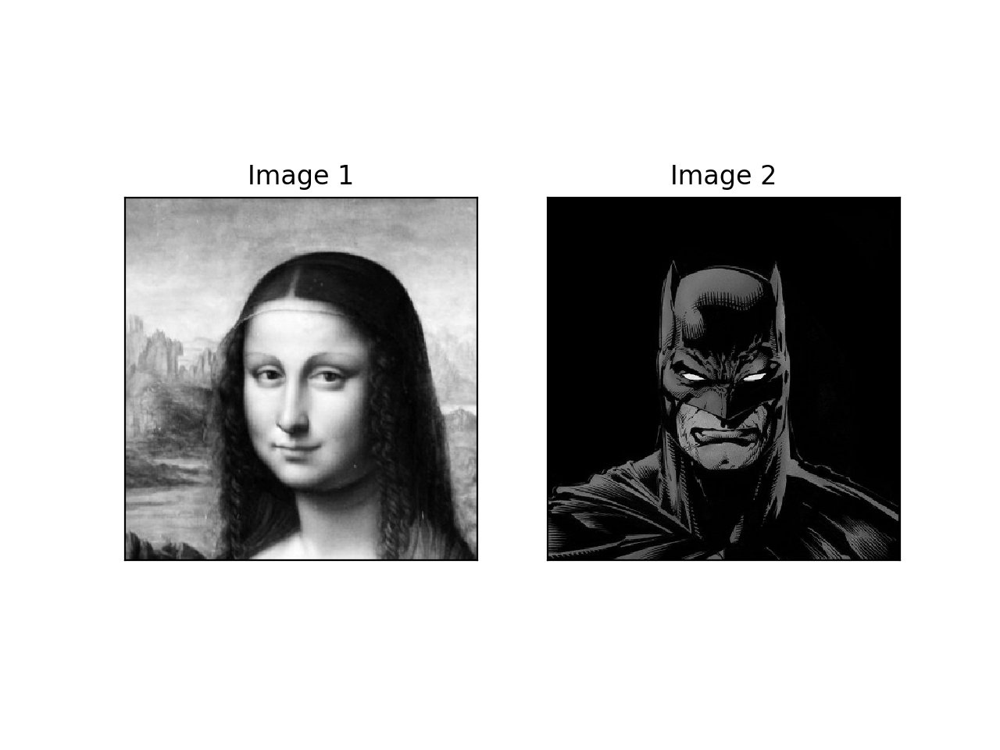

In [20]:
#Images sanity check
fig, axes = plt.subplots(1, 2)
axes[0].imshow(im1,cmap='gray')
axes[0].set_title('Image 1'), axes[0].set_xticks([]), axes[0].set_yticks([])
axes[1].imshow(im2,cmap='gray')
axes[1].set_title('Image 2'), axes[1].set_xticks([]), axes[1].set_yticks([]);

In [21]:
cutoff_low = 10
cutoff_high = 10

lisaman = hybridImage(im2, im1, cutoff_low, cutoff_high)
# cv2.imshow("image", im_hybrid)

<IPython.core.display.Javascript object>


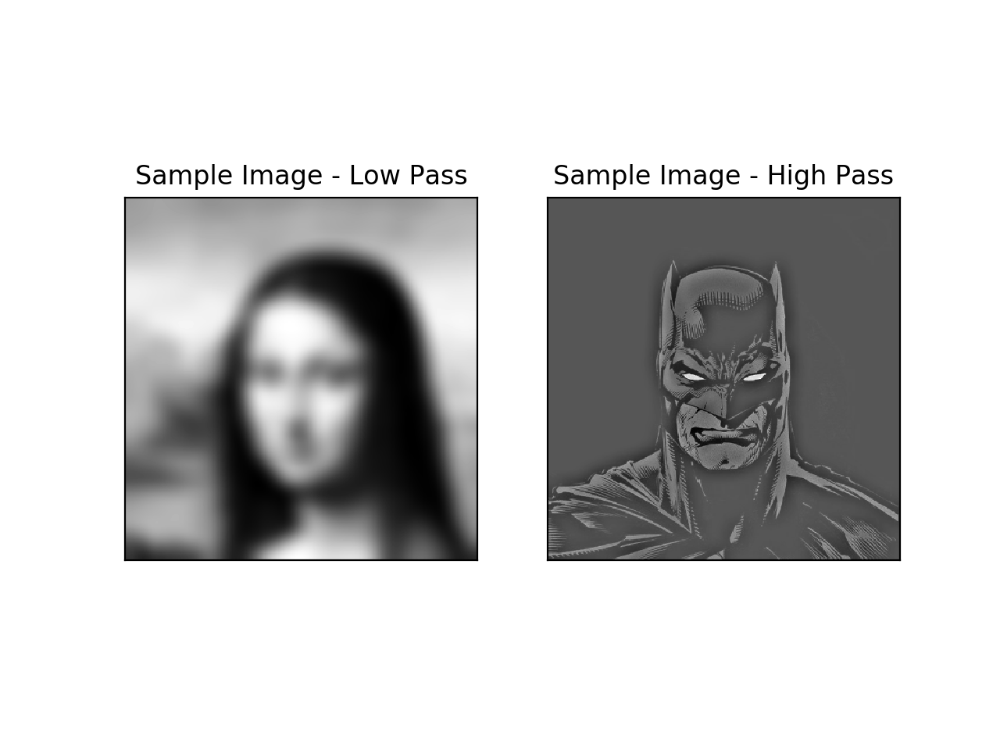

In [22]:
# Image Sanity Check
lowPassImage = cv2.GaussianBlur(im1, (35,35), cutoff_low)
lowPassImage2 = cv2.GaussianBlur(im2, (35,35), cutoff_high)
highPassImage = cv2.subtract(im2, lowPassImage2)
fig, axes = plt.subplots(1, 2)
axes[0].imshow(lowPassImage,cmap='gray')
axes[0].set_title('Sample Image - Low Pass'), axes[0].set_xticks([]), axes[0].set_yticks([])
axes[1].imshow(highPassImage,cmap='gray')
axes[1].set_title('Sample Image - High Pass'), axes[1].set_xticks([]), axes[1].set_yticks([]);

<IPython.core.display.Javascript object>


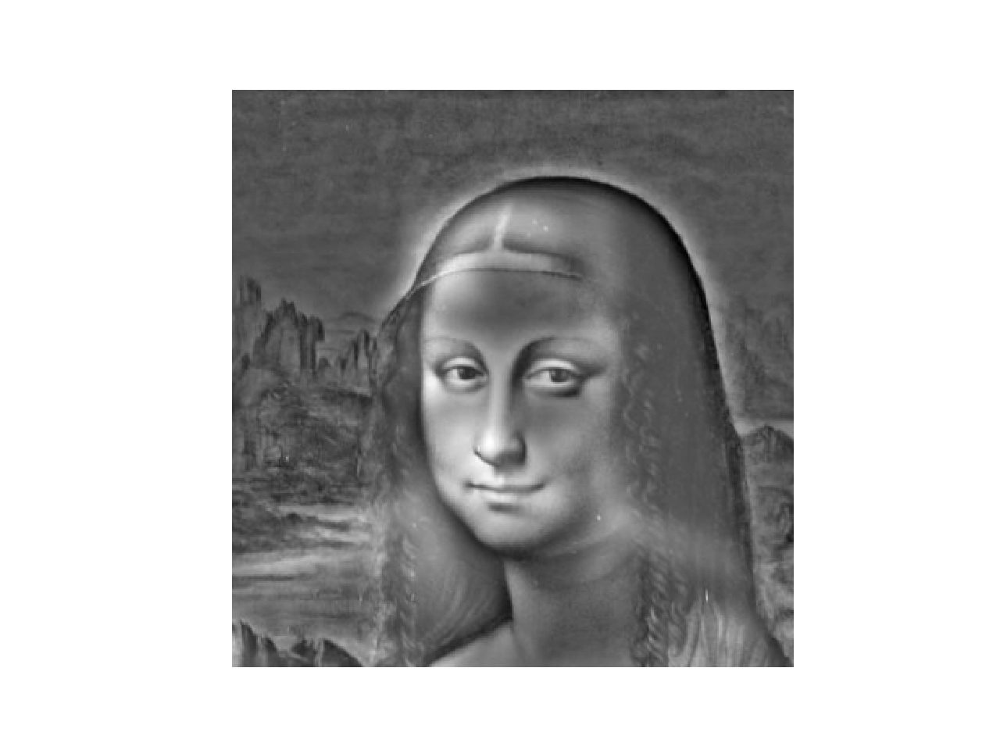

In [23]:
# Optional: Select top left corner and bottom right corner to crop image
# the function returns dictionary of 
# {
#   'cropped_image': np.ndarray of shape H x W
#   'crop_bound': np.ndarray of shape 2x2
# }
cropped_object = utils.interactive_crop(lisaman)

#### Hybrid Image 2: Favorite

#### Includes Fourier Transform at End

In [24]:
im1_file = './HarleyQuinnPortrait.jpg'
im2_file = './Joker_Headshot.jpg'

im1 = cv2.imread(im1_file, cv2.IMREAD_GRAYSCALE)
im2 = cv2.imread(im2_file, cv2.IMREAD_GRAYSCALE)

<IPython.core.display.Javascript object>


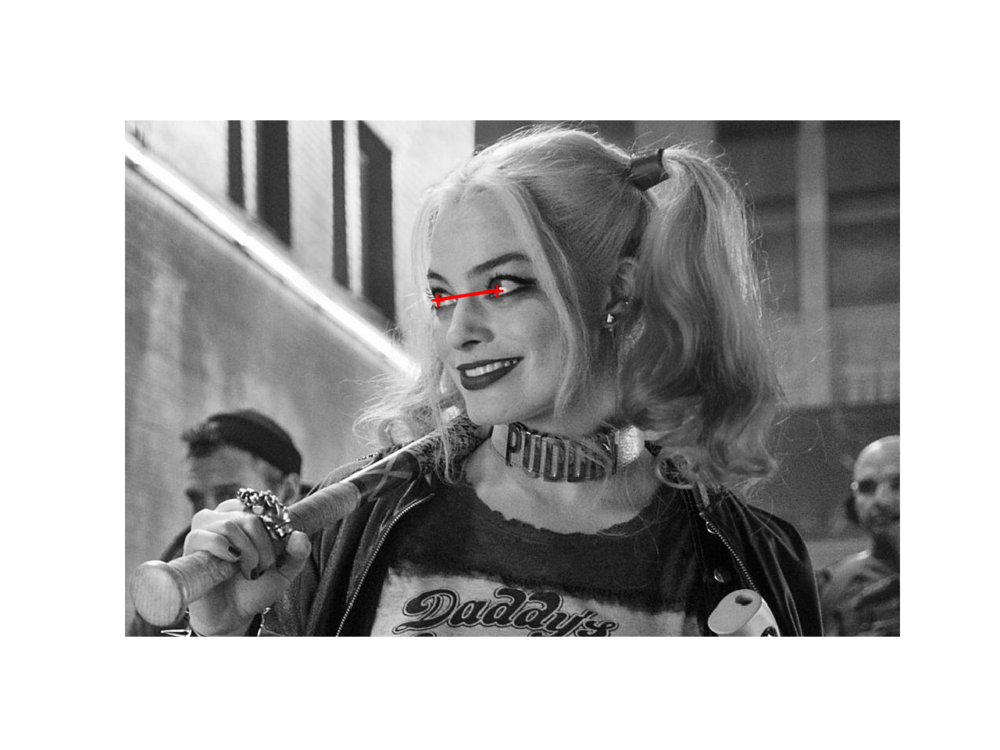

In [25]:
pts_im1 = utils.prompt_eye_selection(im1)

<IPython.core.display.Javascript object>


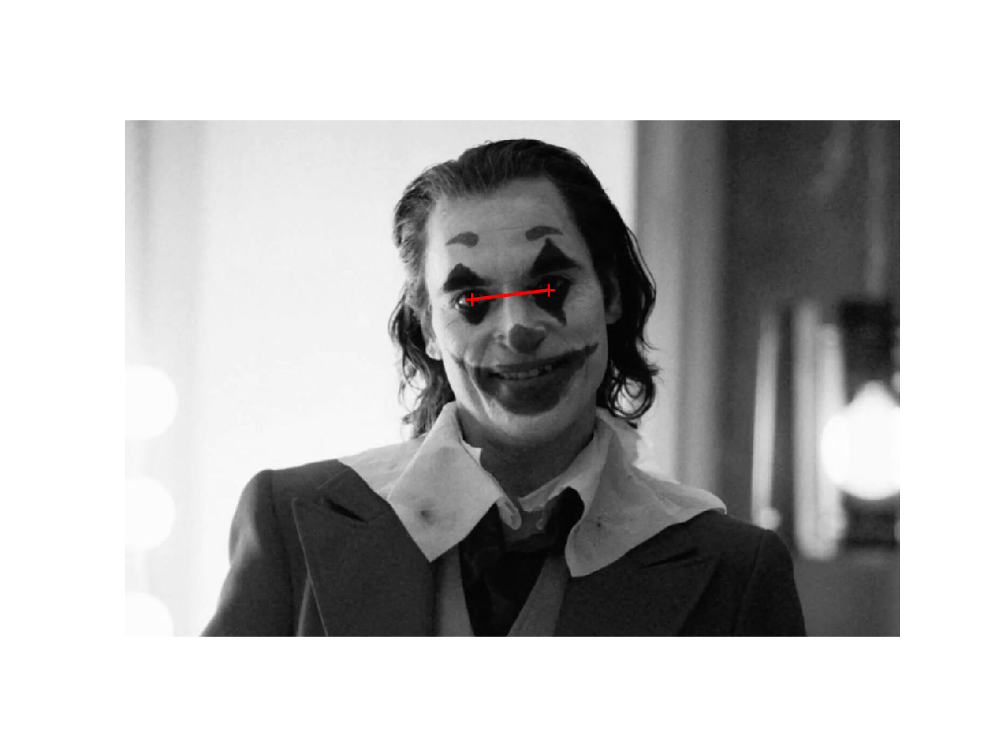

In [27]:
pts_im2 = utils.prompt_eye_selection(im2)

In [28]:
im1, im2 = utils.align_images(im1_file, im2_file,pts_im1,pts_im2,save_images=False)
# convert to grayscale
im1 = cv2.cvtColor(im1, cv2.COLOR_BGR2GRAY) / 255.0
im2 = cv2.cvtColor(im2, cv2.COLOR_BGR2GRAY) / 255.0

<IPython.core.display.Javascript object>


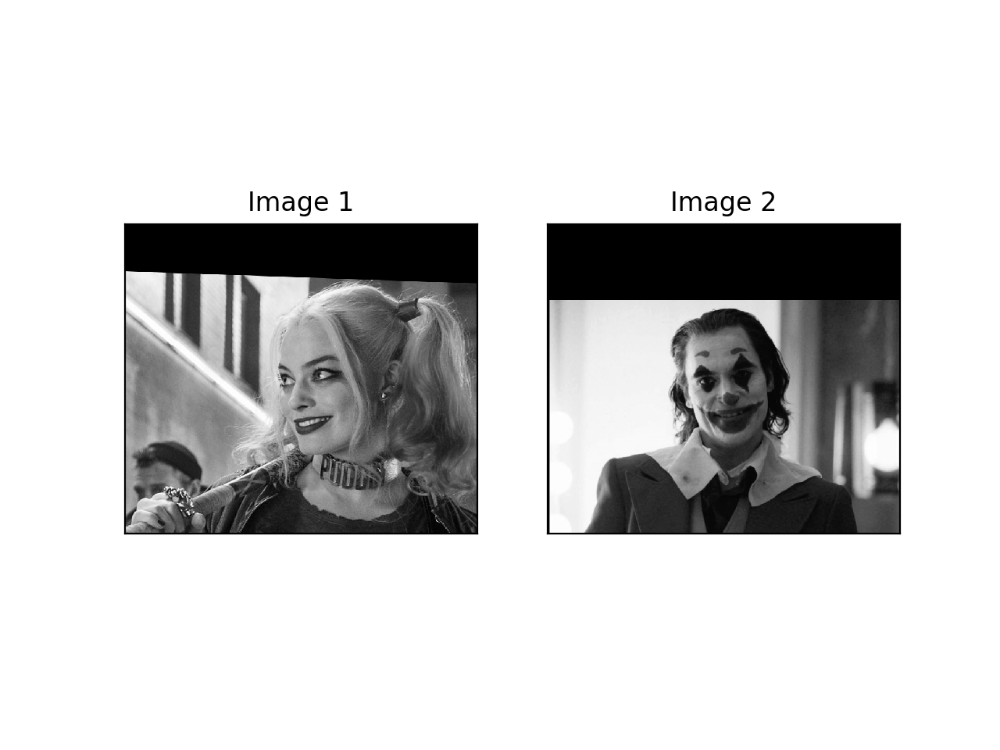

In [29]:
#Images sanity check for Gray Images
fig, axes = plt.subplots(1, 2)
axes[0].imshow(im1,cmap='gray')
axes[0].set_title('Image 1'), axes[0].set_xticks([]), axes[0].set_yticks([])
axes[1].imshow(im2,cmap='gray')
axes[1].set_title('Image 2'), axes[1].set_xticks([]), axes[1].set_yticks([]);

In [30]:
cutoff_low = 5
cutoff_high = 15

quinnjoker = hybridImage(im1, im2, cutoff_low, cutoff_high)

<IPython.core.display.Javascript object>


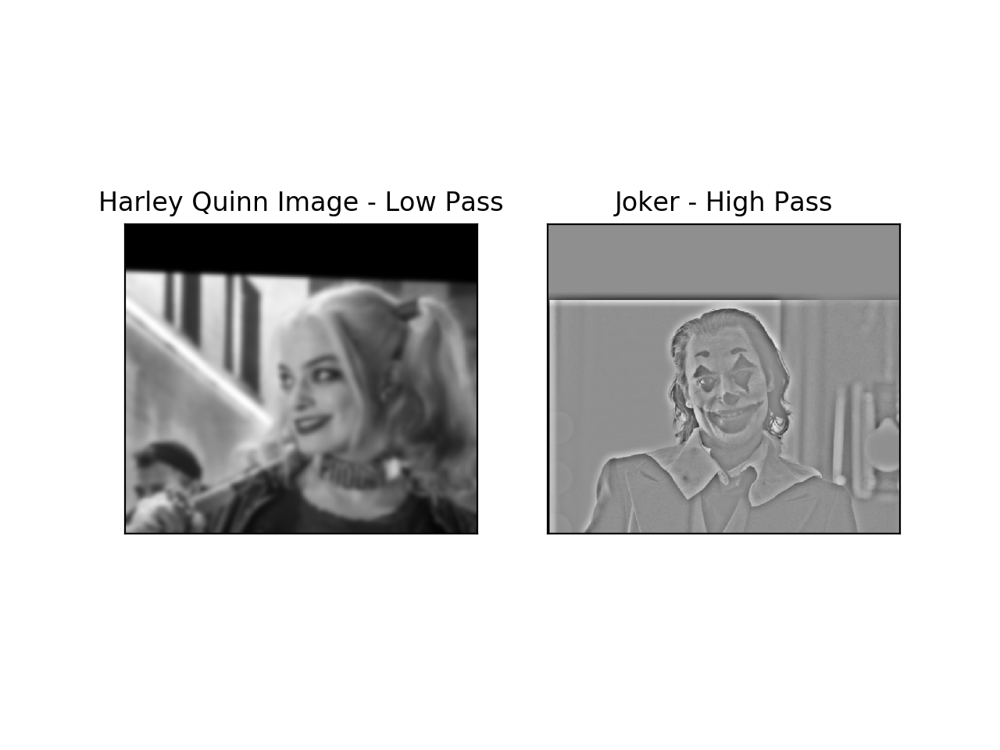

In [31]:
# Image Sanity Check for Filtered Images
lowPassImage = cv2.GaussianBlur(im1, (35,35), cutoff_low)
lowPassImage2 = cv2.GaussianBlur(im2, (35,35), cutoff_high)
highPassImage = cv2.subtract(im2, lowPassImage2)
fig, axes = plt.subplots(1, 2)
axes[0].imshow(lowPassImage,cmap='gray')
axes[0].set_title('Harley Quinn Image - Low Pass'), axes[0].set_xticks([]), axes[0].set_yticks([])
axes[1].imshow(highPassImage,cmap='gray')
axes[1].set_title('Joker - High Pass'), axes[1].set_xticks([]), axes[1].set_yticks([]);

<IPython.core.display.Javascript object>


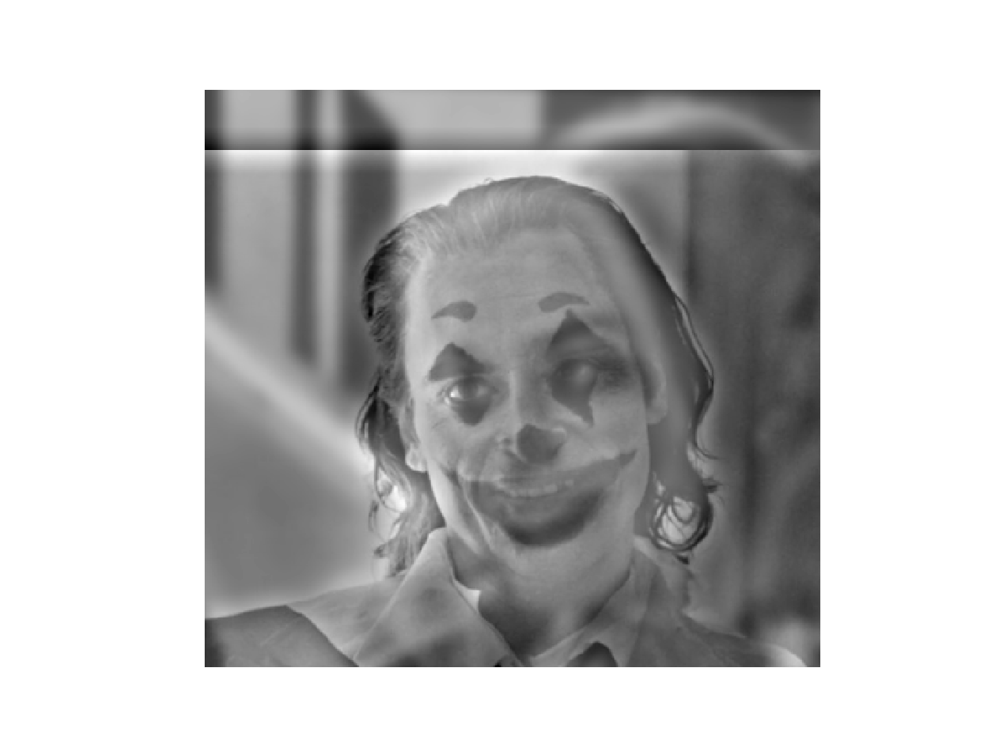

In [32]:
cropped_object = utils.interactive_crop(quinnjoker)

In [33]:
# In Python, you can compute and display the 2D Fourier transform using Matplotlib and Numpy with: 
# plt.imshow(numpy.log(numpy.abs(numpy.fft.fftshift(numpy.fft.fft2(gray_image)))))

# Image that is not FFT
def nonFFTimage(img, subplot):
    subplot.imshow(np.log(np.abs(np.fft.fftshift(np.fft.fft2(img, (2048, 2048))))))

<IPython.core.display.Javascript object>


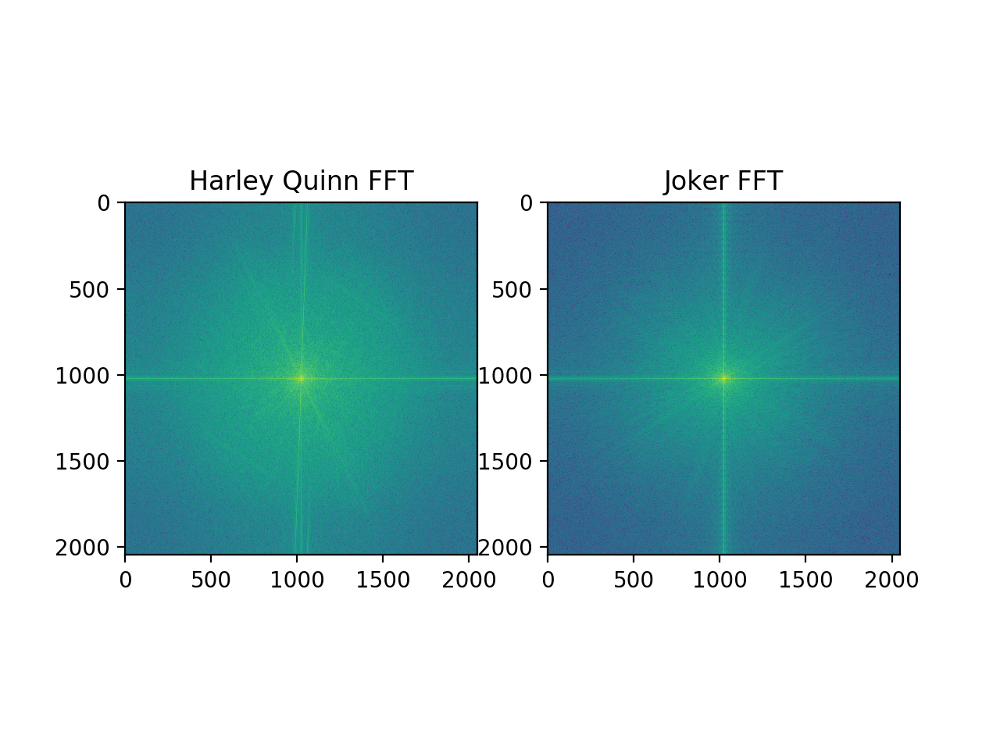

Text(0.5, 1.0, 'Joker FFT')

In [34]:
# FFT of Two Input Images
fig, ax = plt.subplots(1,2)
nonFFTimage(im1, ax[0])
nonFFTimage(im2, ax[1])
ax[0].set_title("Harley Quinn FFT")
ax[1].set_title("Joker FFT")

<IPython.core.display.Javascript object>


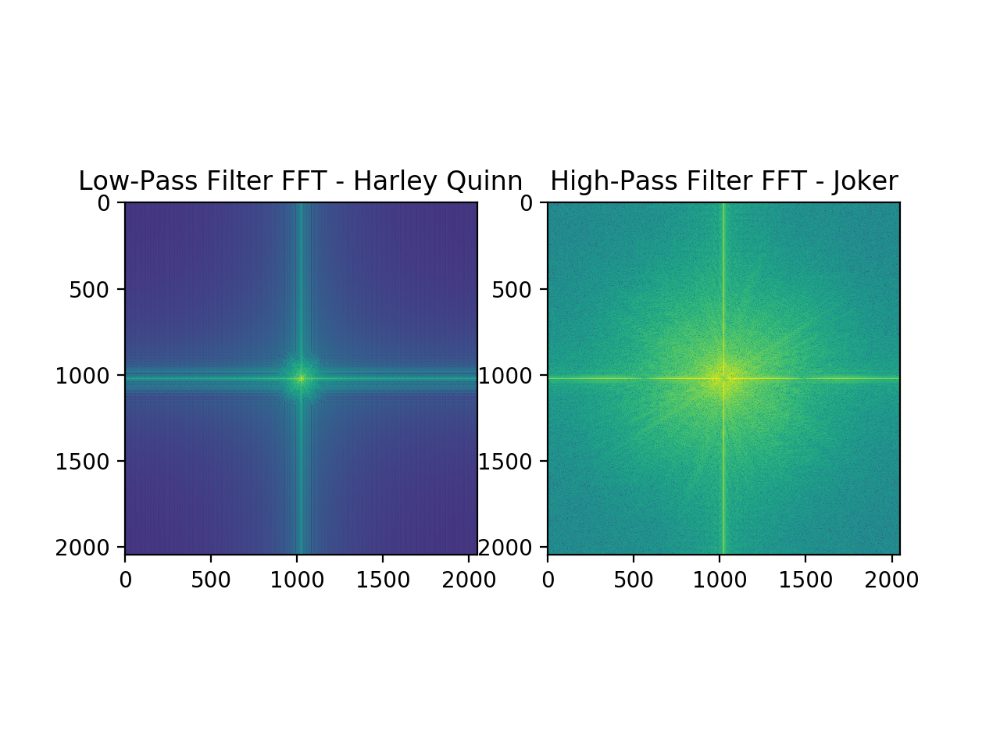

Text(0.5, 1.0, 'High-Pass Filter FFT - Joker')

In [35]:
# FFT of Filtered Images
fig, ax = plt.subplots(1,2)
nonFFTimage(lowPassImage, ax[0])
nonFFTimage(highPassImage, ax[1])
ax[0].set_title("Low-Pass Filter FFT - Harley Quinn")
ax[1].set_title("High-Pass Filter FFT - Joker")

<IPython.core.display.Javascript object>


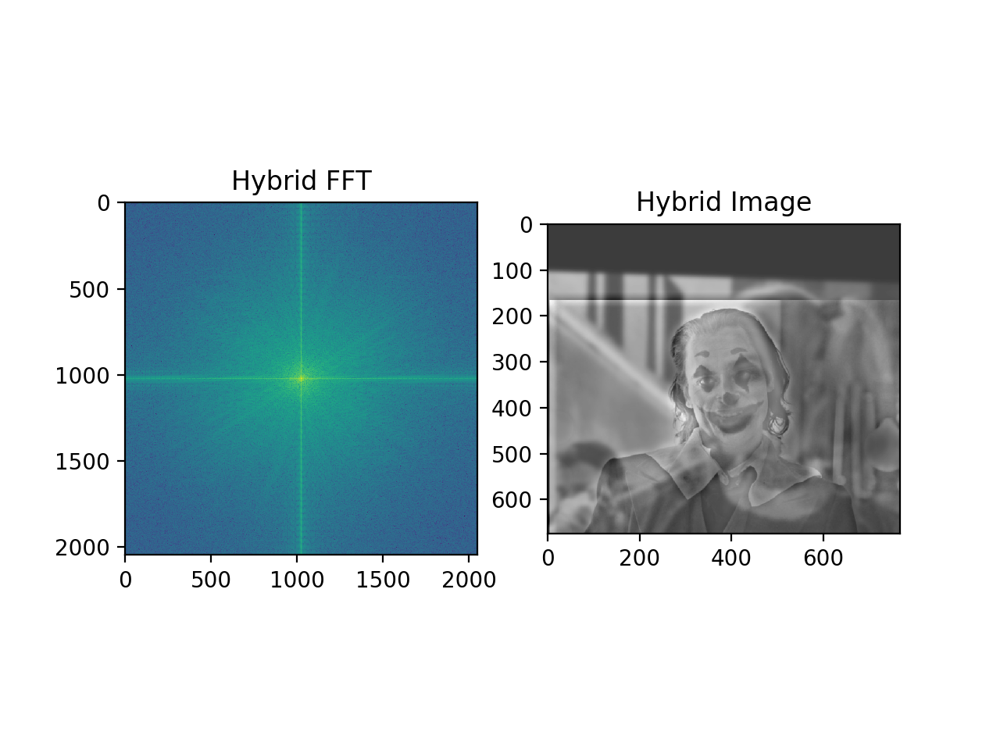

Text(0.5, 1.0, 'Hybrid Image')

In [36]:
# FFT of Hybrid Image
quinnjokerFFT = hybridImage(im1, im2, cutoff_low, cutoff_high)
fig, ax = plt.subplots(1,2)
nonFFTimage(quinnjokerFFT, ax[0])
ax[1].imshow(quinnjoker, cmap="gray")
ax[0].set_title("Hybrid FFT")
ax[1].set_title("Hybrid Image")


#### Hybrid Image 3: Failure

In [37]:
im1_file = './Batman.jpg'
im2_file = './WonderWoman.jpg'

im1 = cv2.imread(im1_file, cv2.IMREAD_GRAYSCALE)
im2 = cv2.imread(im2_file, cv2.IMREAD_GRAYSCALE)

<IPython.core.display.Javascript object>


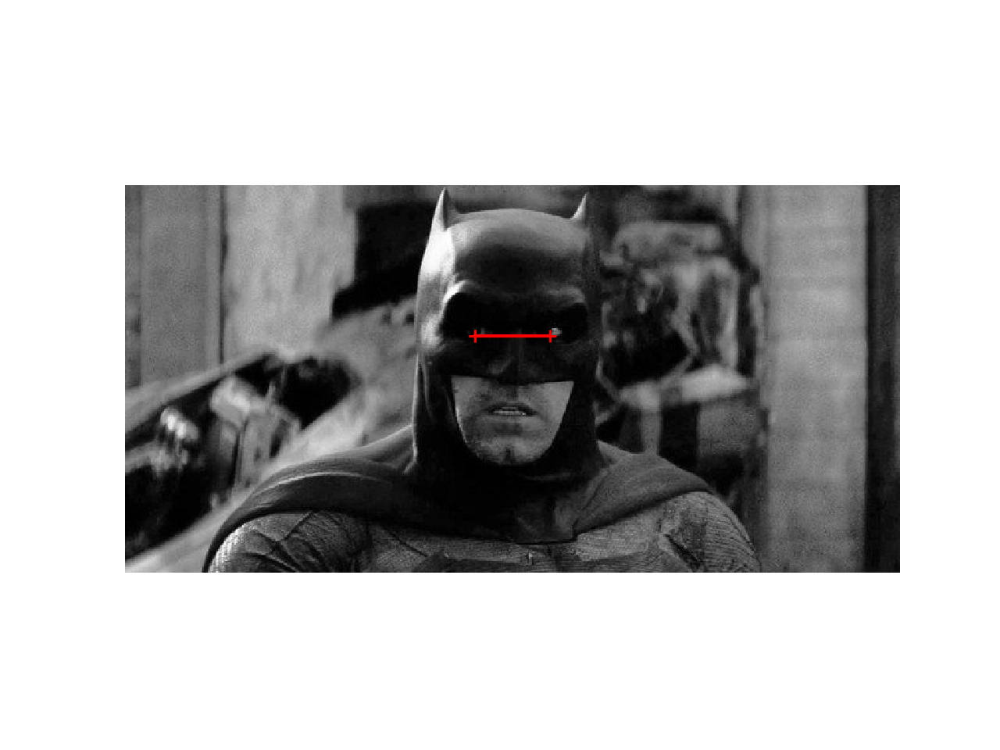

In [38]:
pts_im1 = utils.prompt_eye_selection(im1)

<IPython.core.display.Javascript object>


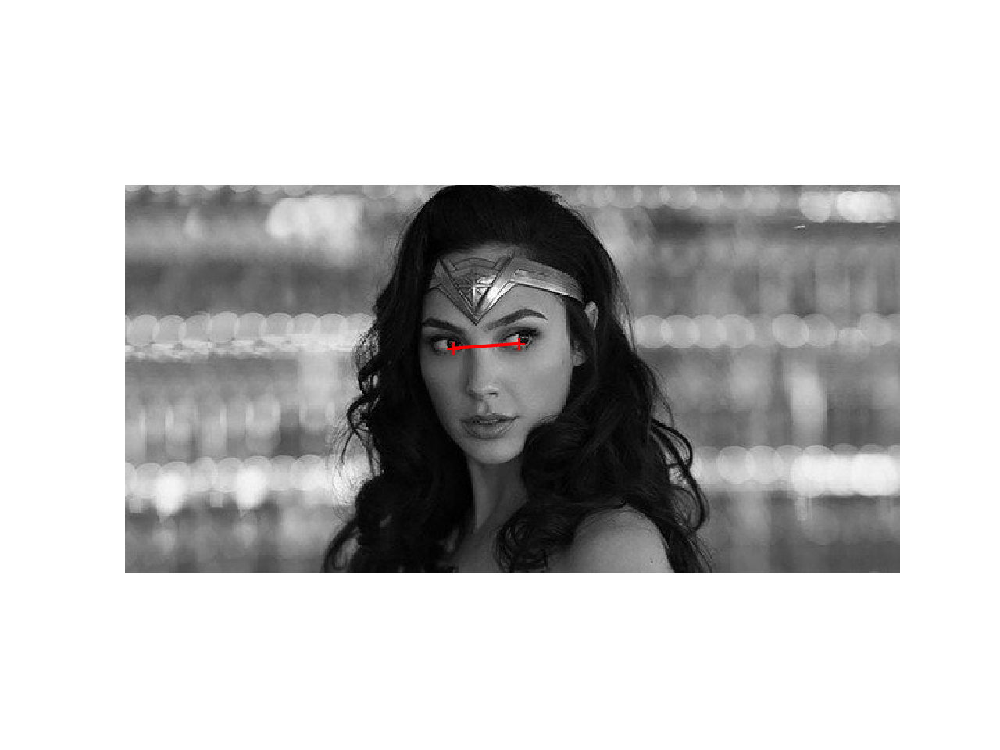

In [39]:
pts_im2 = utils.prompt_eye_selection(im2)

In [40]:
im1, im2 = utils.align_images(im1_file, im2_file,pts_im1,pts_im2,save_images=False)

In [41]:
# convert to grayscale
im1 = cv2.cvtColor(im1, cv2.COLOR_BGR2GRAY) / 255.0
im2 = cv2.cvtColor(im2, cv2.COLOR_BGR2GRAY) / 255.0

<IPython.core.display.Javascript object>


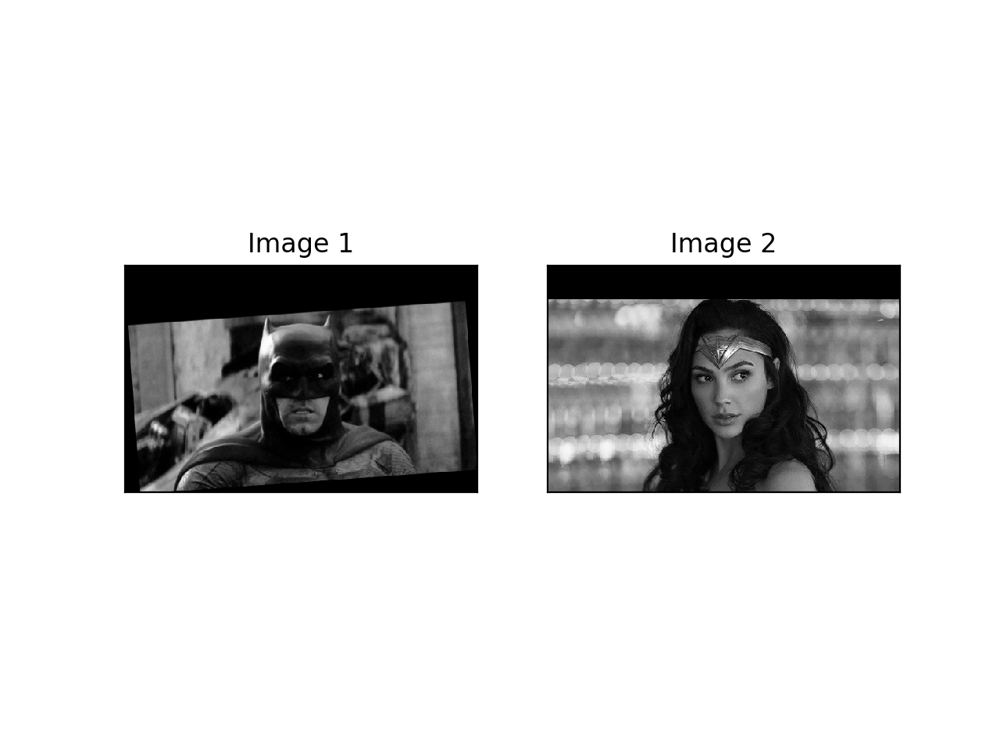

In [42]:
#Images sanity check
fig, axes = plt.subplots(1, 2)
axes[0].imshow(im1,cmap='gray')
axes[0].set_title('Image 1'), axes[0].set_xticks([]), axes[0].set_yticks([])
axes[1].imshow(im2,cmap='gray')
axes[1].set_title('Image 2'), axes[1].set_xticks([]), axes[1].set_yticks([]);

<IPython.core.display.Javascript object>


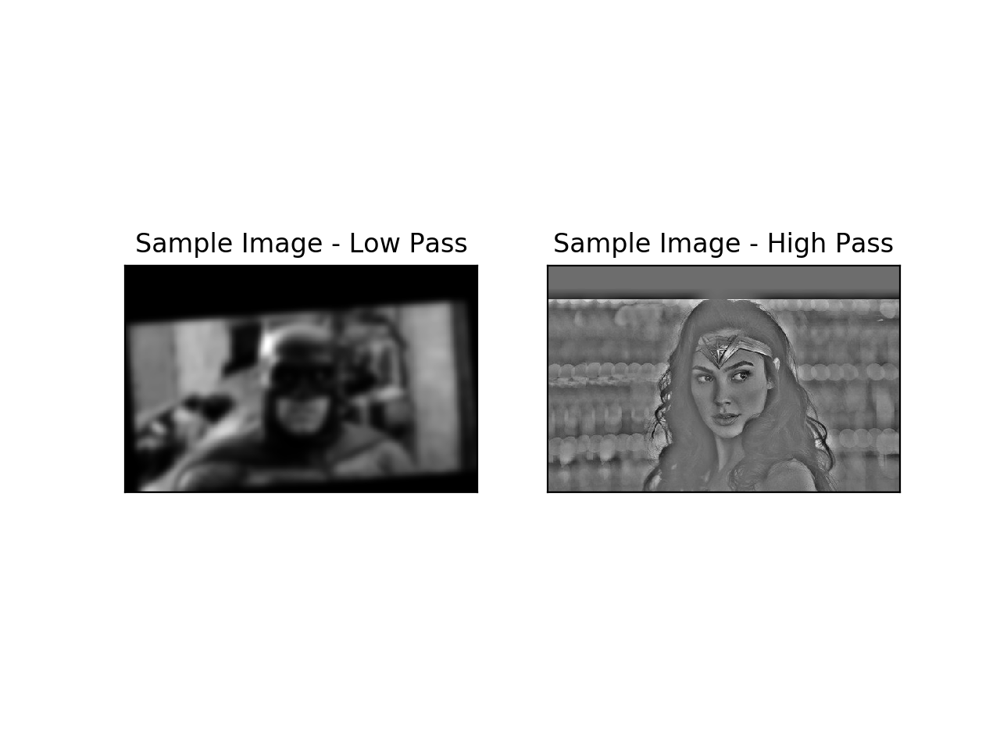

In [43]:
# Image Sanity Check
lowPassImage = cv2.GaussianBlur(im1, (35,35), cutoff_low)
lowPassImage2 = cv2.GaussianBlur(im2, (35,35), cutoff_high)
highPassImage = cv2.subtract(im2, lowPassImage2)
fig, axes = plt.subplots(1, 2)
axes[0].imshow(lowPassImage,cmap='gray')
axes[0].set_title('Sample Image - Low Pass'), axes[0].set_xticks([]), axes[0].set_yticks([])
axes[1].imshow(highPassImage,cmap='gray')
axes[1].set_title('Sample Image - High Pass'), axes[1].set_xticks([]), axes[1].set_yticks([]);

In [44]:
cutoff_low = 30
cutoff_high = 30

manwoman = hybridImage(im1, im2, cutoff_low, cutoff_high)

<IPython.core.display.Javascript object>


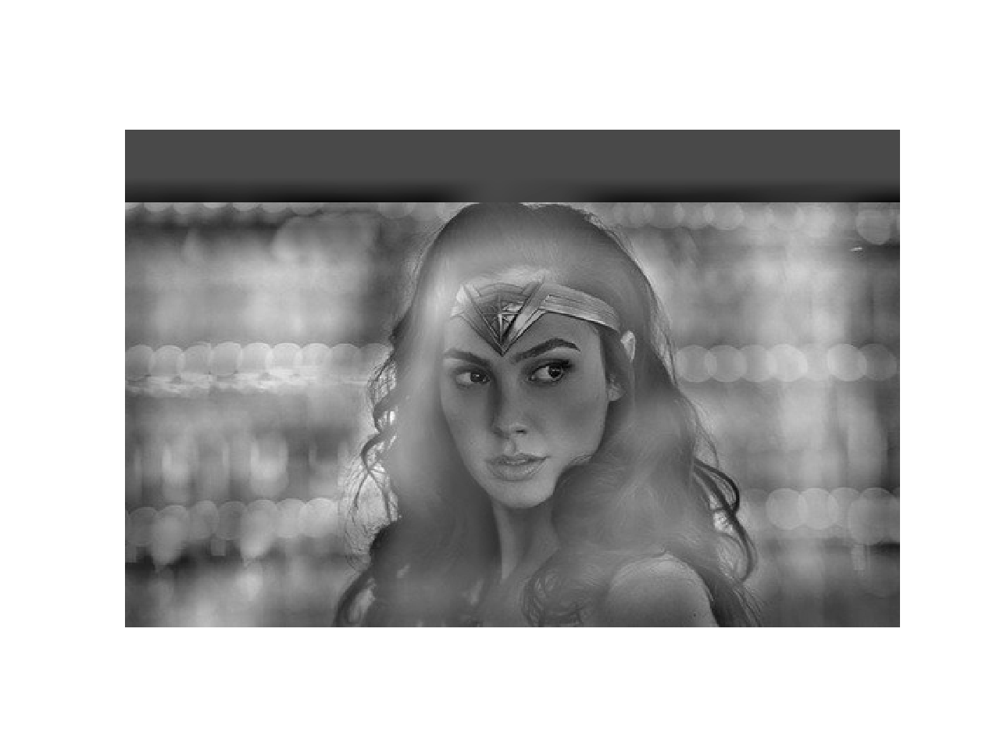

In [45]:
# Optional: Select top left corner and bottom right corner to crop image
# the function returns dictionary of 
# {
#   'cropped_image': np.ndarray of shape H x W
#   'crop_bound': np.ndarray of shape 2x2
# }
cropped_object = utils.interactive_crop(manwoman)

#### Hybrid Image 4: BounceDown

In [46]:
im1_file = './Aquaman.jpg'
im2_file = './Deadpool.jpg'

im1 = cv2.imread(im1_file, cv2.IMREAD_GRAYSCALE)
im2 = cv2.imread(im2_file, cv2.IMREAD_GRAYSCALE)

<IPython.core.display.Javascript object>


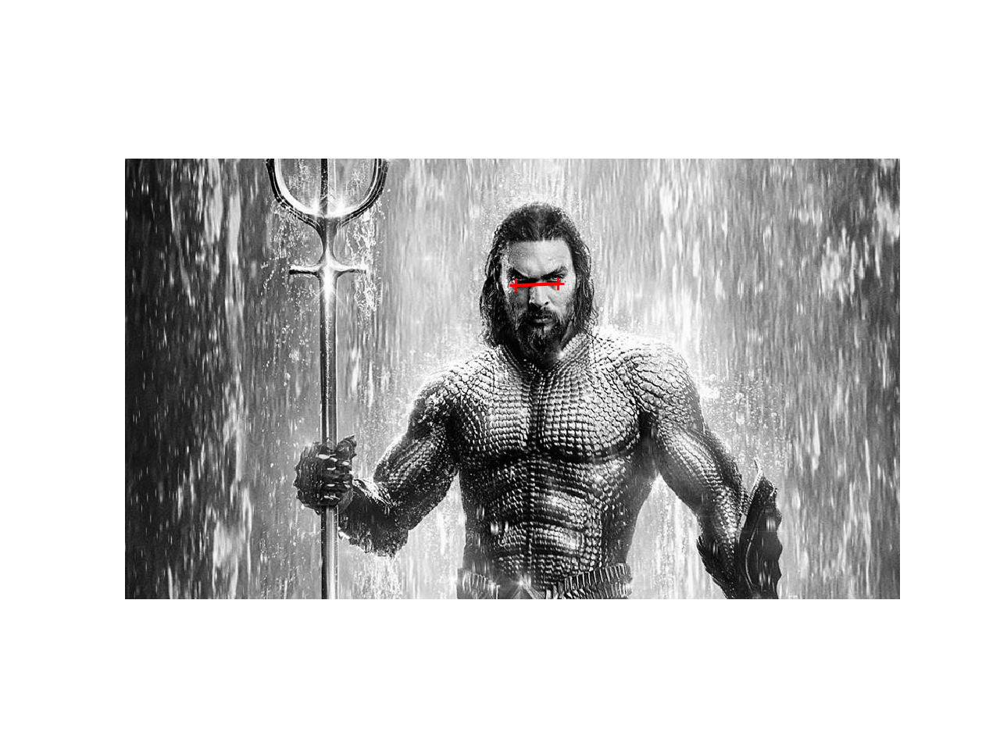

In [47]:
pts_im1 = utils.prompt_eye_selection(im1)

<IPython.core.display.Javascript object>


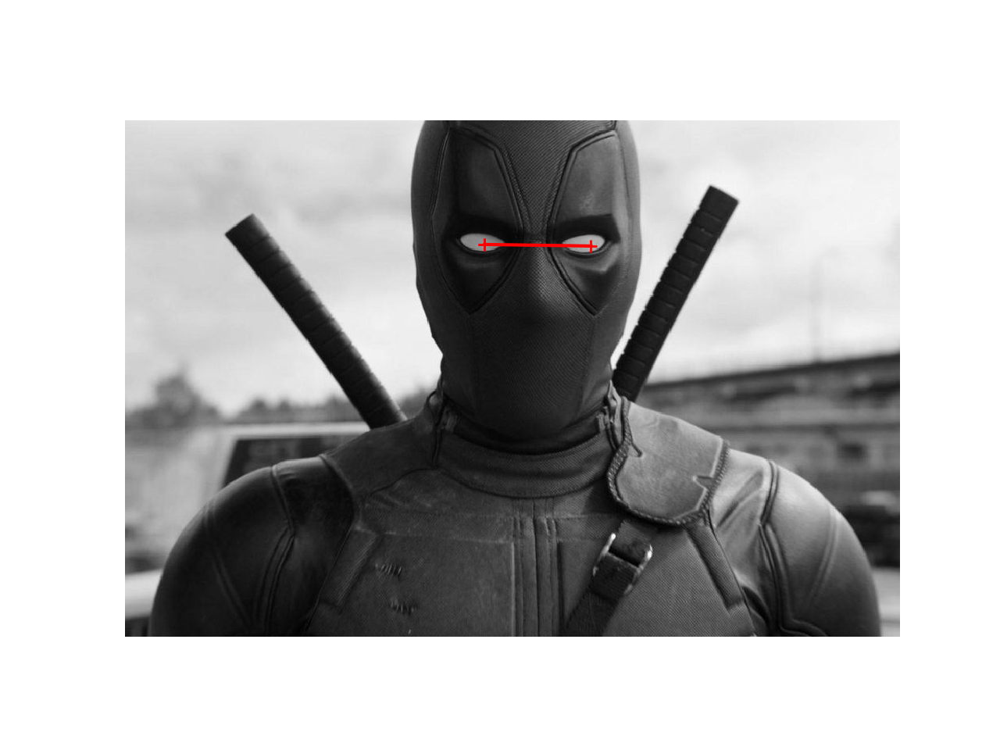

In [48]:
pts_im2 = utils.prompt_eye_selection(im2)

In [49]:
im1, im2 = utils.align_images(im1_file, im2_file,pts_im1,pts_im2,save_images=False)

In [50]:
# convert to grayscale
im1 = cv2.cvtColor(im1, cv2.COLOR_BGR2GRAY) / 255.0
im2 = cv2.cvtColor(im2, cv2.COLOR_BGR2GRAY) / 255.0

<IPython.core.display.Javascript object>


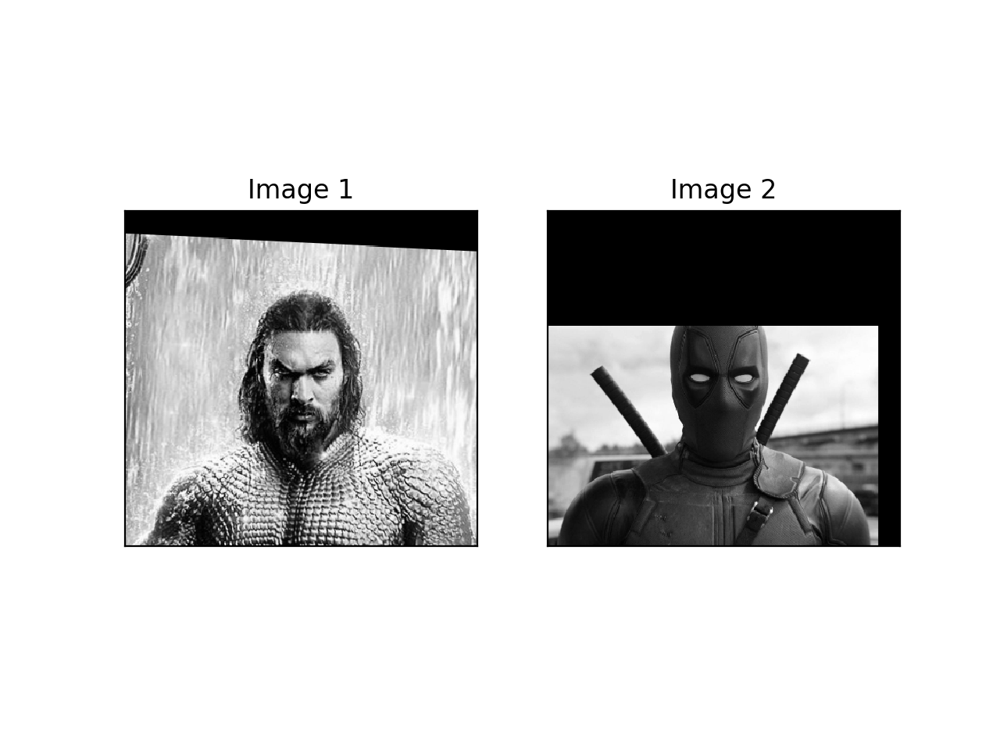

In [51]:
#Images sanity check
fig, axes = plt.subplots(1, 2)
axes[0].imshow(im1,cmap='gray')
axes[0].set_title('Image 1'), axes[0].set_xticks([]), axes[0].set_yticks([])
axes[1].imshow(im2,cmap='gray')
axes[1].set_title('Image 2'), axes[1].set_xticks([]), axes[1].set_yticks([]);

<IPython.core.display.Javascript object>


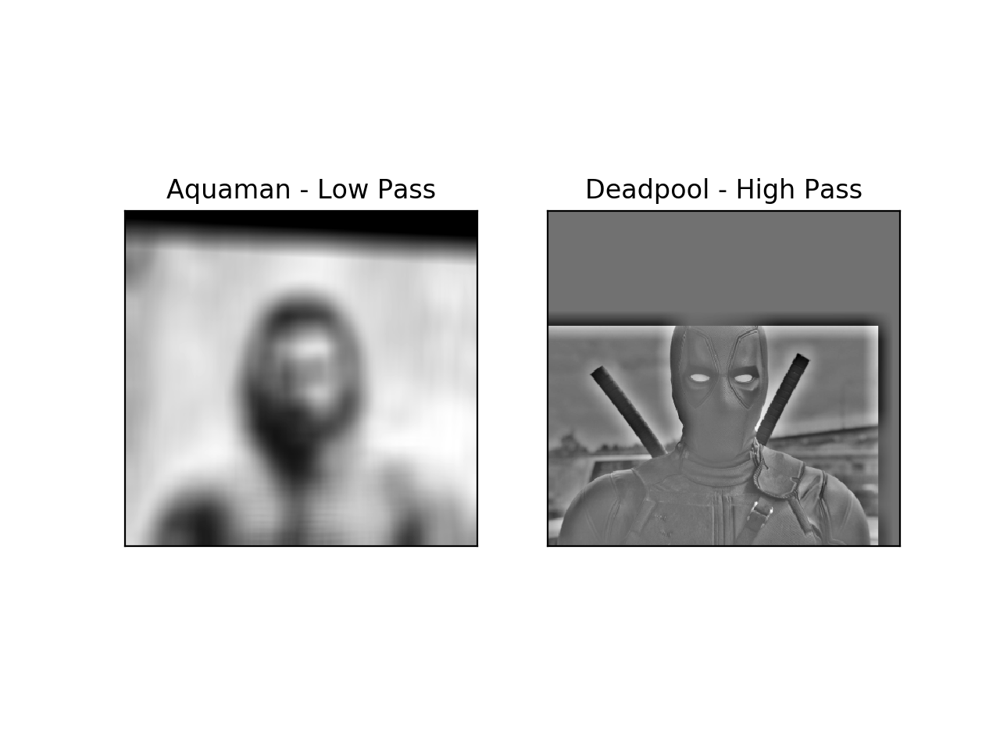

In [52]:
# Image Sanity Check
lowPassImage = cv2.GaussianBlur(im1, (35,35), cutoff_low)
lowPassImage2 = cv2.GaussianBlur(im2, (35,35), cutoff_high)
highPassImage = cv2.subtract(im2, lowPassImage2)
fig, axes = plt.subplots(1, 2)
axes[0].imshow(lowPassImage,cmap='gray')
axes[0].set_title('Aquaman - Low Pass'), axes[0].set_xticks([]), axes[0].set_yticks([])
axes[1].imshow(highPassImage,cmap='gray')
axes[1].set_title('Deadpool - High Pass'), axes[1].set_xticks([]), axes[1].set_yticks([]);

In [53]:
cutoff_low = 15
cutoff_high = 25

manwoman = hybridImage(im1, im2, cutoff_low, cutoff_high)

<IPython.core.display.Javascript object>


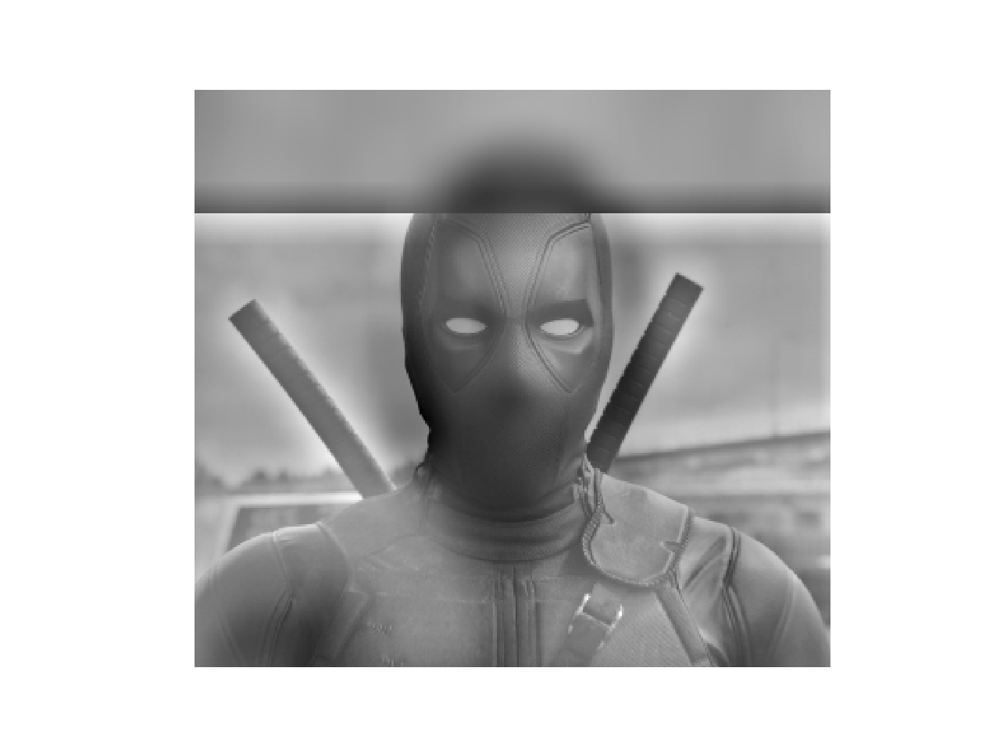

In [54]:
# Optional: Select top left corner and bottom right corner to crop image
# the function returns dictionary of 
# {
#   'cropped_image': np.ndarray of shape H x W
#   'crop_bound': np.ndarray of shape 2x2
# }
cropped_object = utils.interactive_crop(manwoman)

### Part II: Image Enhancement

##### Two out of three types of image enhancement are required.  Choose a good image to showcase each type and implement a method.  This code doesn't rely on the hybrid image part.

#### Contrast enhancement

Gamma Correction

<IPython.core.display.Javascript object>


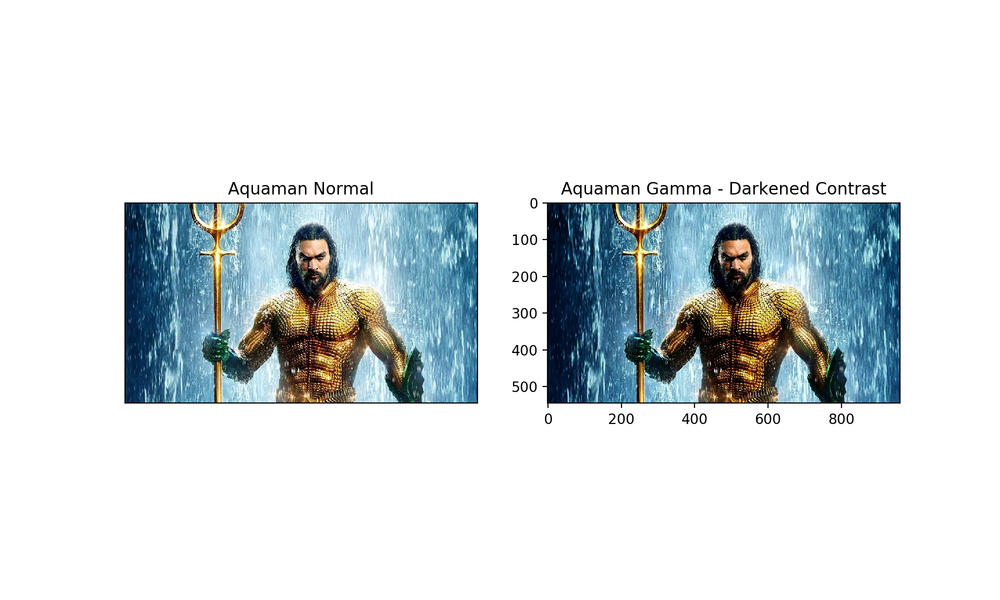

(Text(0.5, 1.0, 'Aquaman Gamma - Darkened Contrast'), [], [])

In [55]:
aquaman = cv2.imread("Aquaman.jpg")
aquamanOriginal = cv2.cvtColor(aquaman, cv2.COLOR_BGR2RGB)
# gamma = ((aquamanGamma / 255) ** 2.0)
aquamanGamma = ((aquamanOriginal / 255) ** 1.5)
# gamma = ((aquamanGamma / 255) ** 1.0)
# gamma = ((aquamanGamma / 255) ** 0.5) #Too Bright
fig, ax = plt.subplots(1, 2, figsize=(10,6))
ax[0].imshow(aquamanOriginal)
ax[1].imshow(aquamanGamma)
ax[0].set_title('Aquaman Normal'), ax[0].set_xticks([]), ax[0].set_yticks([])
ax[1].set_title('Aquaman Gamma - Darkened Contrast'), ax[0].set_xticks([]), ax[0].set_yticks([])

Histogram Equalization

<IPython.core.display.Javascript object>


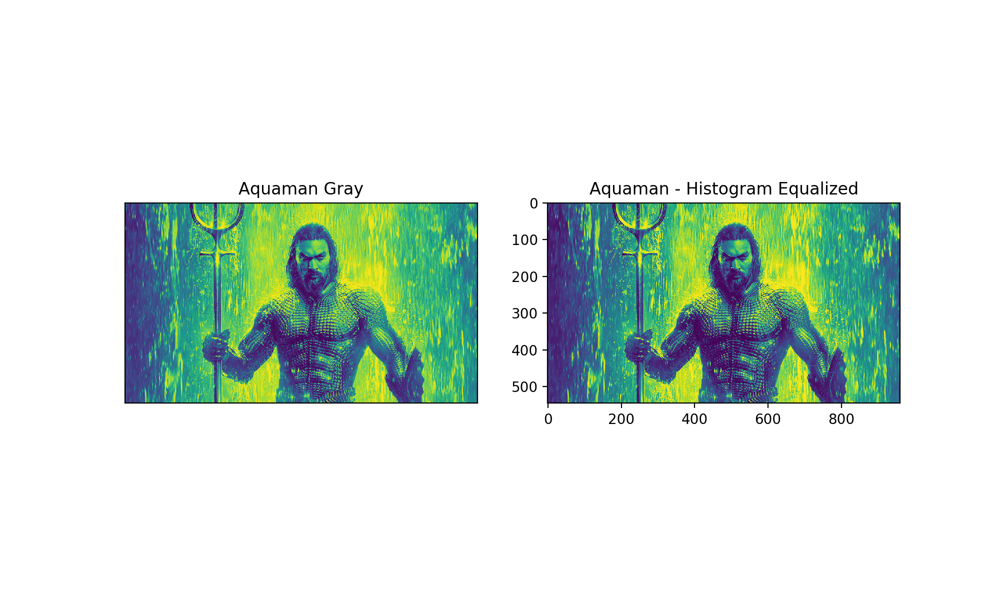

(Text(0.5, 1.0, 'Aquaman - Histogram Equalized'), [], [])

In [56]:
# aquaman = cv2.imread("Aquaman.jpg")
aquamanGray = cv2.cvtColor(aquamanOriginal, cv2.COLOR_BGR2GRAY)
aquamanHistogram = cv2.equalizeHist(aquamanGray)

fig, ax = plt.subplots(1, 2, figsize=(10,6))
ax[0].imshow(aquamanGray)
ax[1].imshow(aquamanHistogram)
ax[0].set_title('Aquaman Gray'), ax[0].set_xticks([]), ax[0].set_yticks([])
ax[1].set_title('Aquaman - Histogram Equalized'), ax[0].set_xticks([]), ax[0].set_yticks([])

# Source Code Doesn't Work? & Crazy Conversion when attempting to go gray?
# img = cv2.imread('Aquaman.jpg',0)
# equ = cv2.equalizeHist(img)
# res = np.hstack((img,equ)) #stacking images side-by-side
# cv2.imshow('res.png',res)

<IPython.core.display.Javascript object>


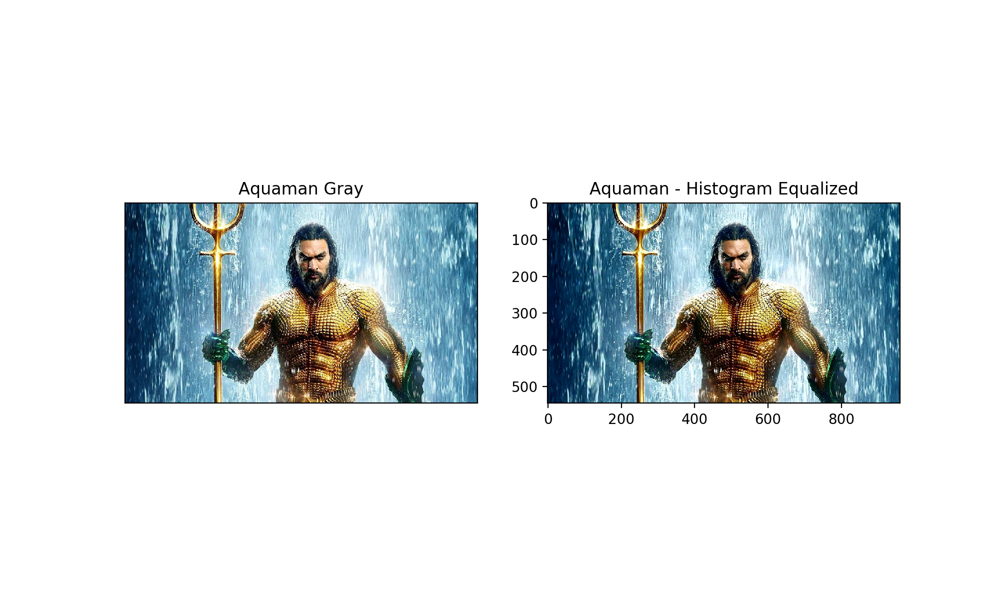

(Text(0.5, 1.0, 'Aquaman - Histogram Equalized'), [], [])

In [57]:
# equalizeHist only works on GrayScale
aquamanGray = cv2.cvtColor(aquamanOriginal, cv2.COLOR_BGR2YUV)

# equalize the histogram of the Y channel
aquamanGray[:,:,0] = cv2.equalizeHist(aquamanGray[:,:,0])

# convert the YUV image back to RGB format
aquamanHistogram = cv2.cvtColor(aquamanGray, cv2.COLOR_YUV2BGR)

fig, ax = plt.subplots(1, 2, figsize=(10,6))
ax[0].imshow(aquamanOriginal)
ax[1].imshow(aquamanHistogram)
ax[0].set_title('Aquaman Gray'), ax[0].set_xticks([]), ax[0].set_yticks([])
ax[1].set_title('Aquaman - Histogram Equalized'), ax[0].set_xticks([]), ax[0].set_yticks([])

# Better! But Does not seem much of a contract enhancement, perhaps a shade or two darker, definitely not as good as gammg

#### Color enhancement 

<IPython.core.display.Javascript object>


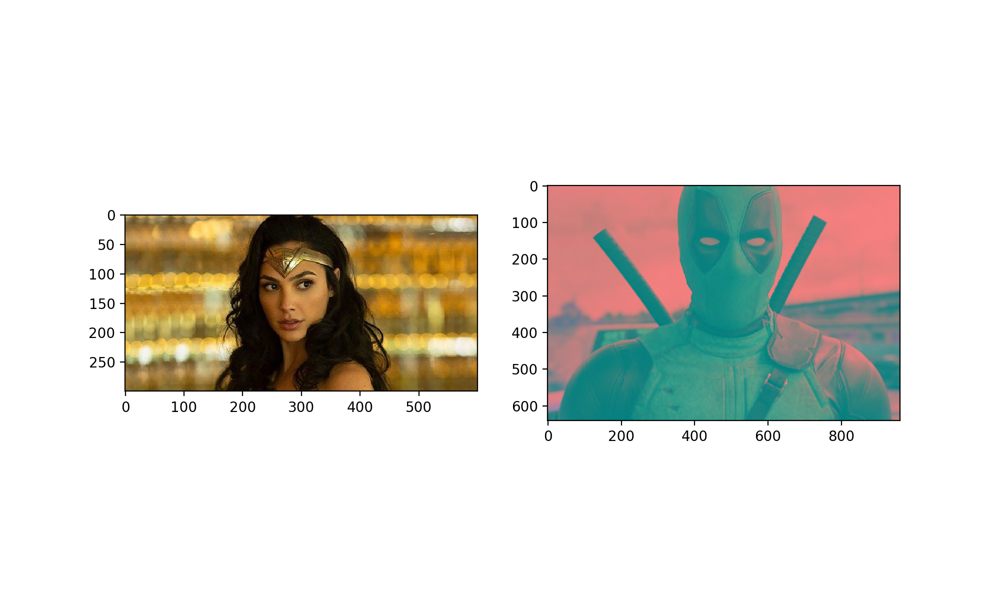

In [58]:
wonderWomanColorEnhance = cv2.imread("WonderWoman.jpg")  
wonderWomanOriginal = cv2.cvtColor(wonderWomanColorEnhance, cv2.COLOR_BGR2RGB)
wonderWomanColorEnhance = cv2.cvtColor(wonderWomanColorEnhance, cv2.COLOR_BGR2HSV)

fig, ax = plt.subplots(1,2, figsize=(10,6))
wonderWomanColorEnhance[:,:,1] = np.clip(wonderWomanColorEnhance[:,:,1] * 2.0, 0, 255).astype("uint8")
wonderWomanEnhanced = cv2.cvtColor(wonderWomanColorEnhance, cv2.COLOR_HSV2RGB)
ax[0].imshow(wonderWomanOriginal)
ax[1].imshow(wonderWomanEnhanced) 

#### Color shift

In [59]:
dp = cv2.imread("Deadpool.jpg")
dp = cv2.cvtColor(dp, cv2.COLOR_BGR2RGB)
plt.imshow(dp)
plt.show()
# converting between RGB and LAB spaces
dpLab = cv2.cvtColor(dp, cv2.COLOR_RGB2LAB)
dpLab2 = cv2.cvtColor(dp, cv2.COLOR_RGB2LAB)
plt.imshow(dpLab)

<IPython.core.display.Javascript object>


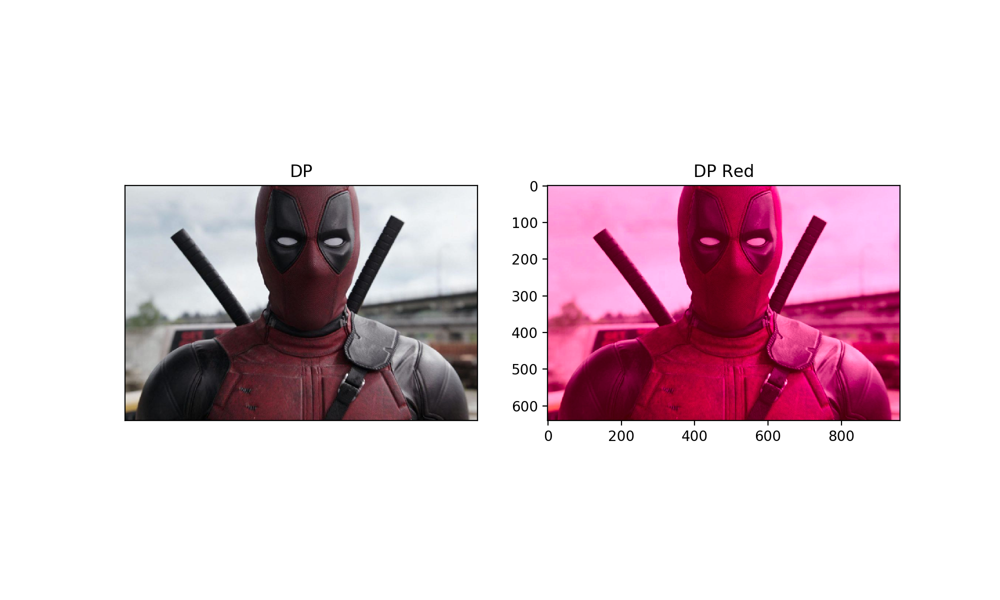

(Text(0.5, 1.0, 'DP Red'), [], [])

In [60]:
# More Red
dpLab[:,:,1] = np.clip(dpLab[:,:,1] * 1.5, 0, 255)
dpRed = cv2.cvtColor(dpLab, cv2.COLOR_LAB2RGB)
fig, ax = plt.subplots(1,2,figsize=(10,6))
ax[0].imshow(dp)
ax[1].imshow(dpRed)
ax[0].set_title('DP'), ax[0].set_xticks([]), ax[0].set_yticks([])
ax[1].set_title('DP Red'), ax[0].set_xticks([]), ax[0].set_yticks([])

<IPython.core.display.Javascript object>


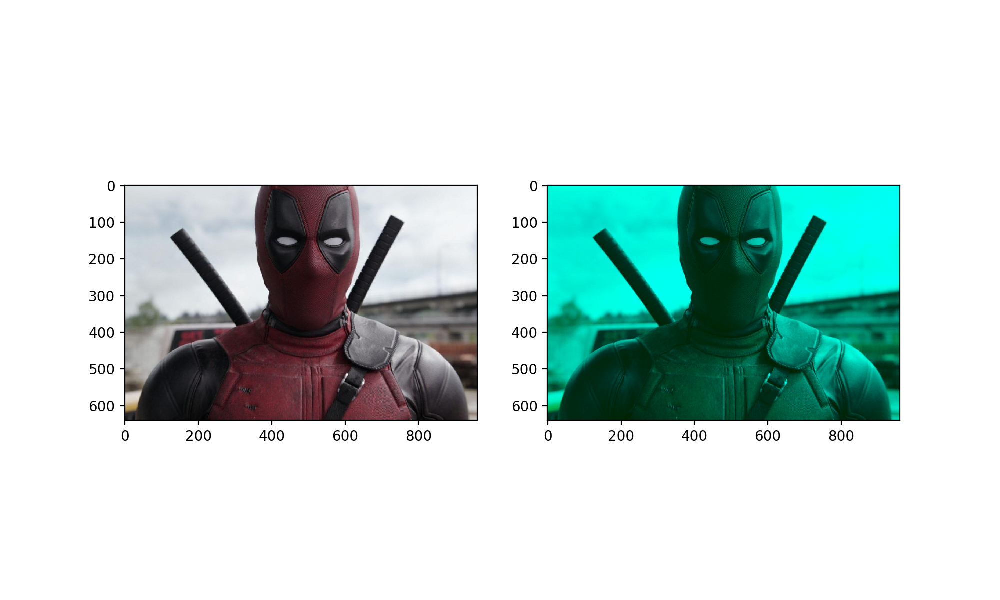

In [61]:
# Less Lellow
dpLab2[:,:,1] = np.clip(dpLab2[:,:,1] * 0.5, 0, 255).astype("uint8")
dpYellow = cv2.cvtColor(dpLab2, cv2.COLOR_LAB2RGB)
fig, ax = plt.subplots(1,2,figsize=(10,6))
ax[0].imshow(dp)
ax[1].imshow(dpYellow)

### Bells & Whistles

#### Color Enhanced Hybrid Image

#### Color for High Frequency

In [62]:
extraFile1 = './HarleyQuinnPortrait.jpg'
extraFile2 = './Joker_Headshot.jpg'

# extra1 = cv2.imread(extraFile1, cv2.IMREAD_GRAYSCALE)
# extra2 = cv2.imread(extraFile2, cv2.IMREAD_GRAYSCALE)

extra1 = cv2.imread(extraFile1, cv2.IMREAD_GRAYSCALE) #Set up for gray low pass
extra2 = cv2.imread(extraFile2) #Setup for color high pass
extra2 = cv2.cvtColor(extra2, cv2.COLOR_BGR2RGB)


<IPython.core.display.Javascript object>


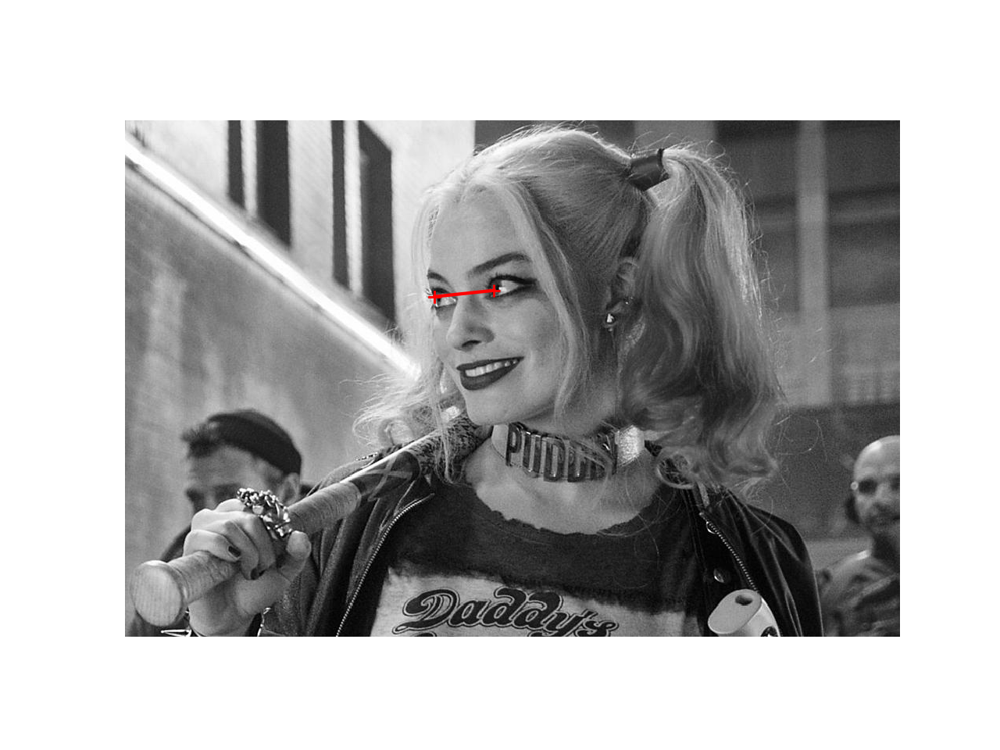

In [63]:
pts_extra1 = utils.prompt_eye_selection(extra1)

<IPython.core.display.Javascript object>


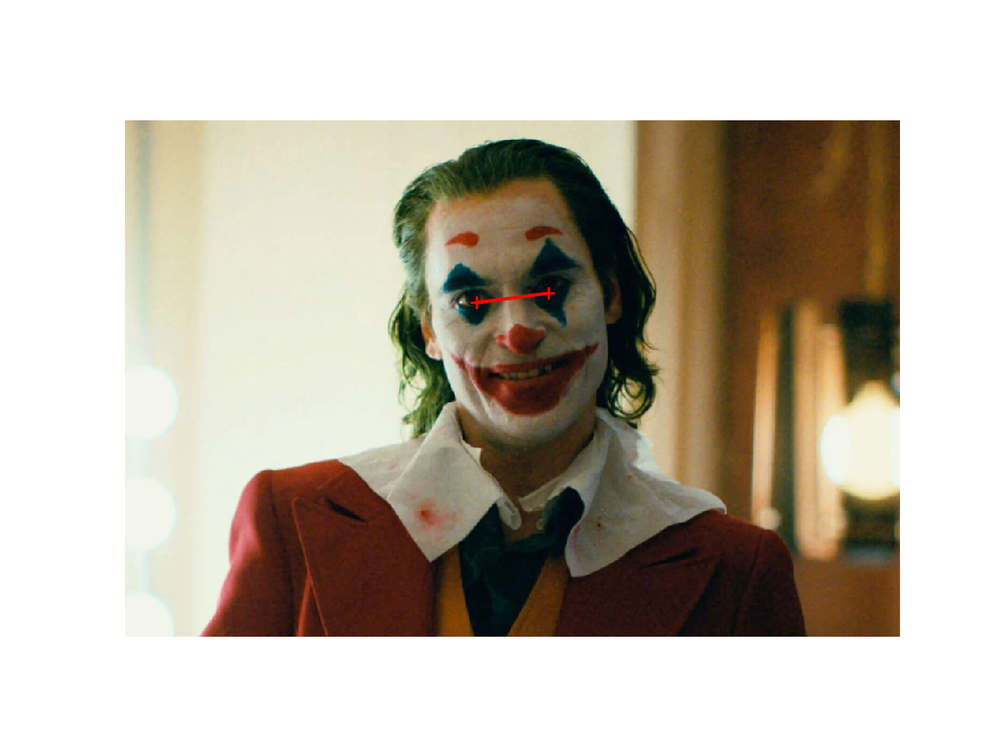

In [64]:
pts_extra2 = utils.prompt_eye_selection(extra2)

In [65]:
extra1, extra2 = utils.align_images(extraFile1, extraFile2,pts_extra1,pts_extra2,save_images=False)
# convert to grayscale
# extra1 = cv2.cvtColor(extra1, cv2.COLOR_BGR2GRAY) / 255.0
# extra1 = cv2.cvtColor(extra1, cv2.COLOR_BGR2RGB)
# extra2 = cv2.cvtColor(extra2, cv2.COLOR_BGR2GRAY) / 255.0

In [66]:
# #Images sanity check
# fig, axes = plt.subplots(1, 2)
# axes[0].imshow(extra1)
# axes[0].set_title('Image 1'), axes[0].set_xticks([]), axes[0].set_yticks([])
# axes[1].imshow(extra2,cmap='gray')
# axes[1].set_title('Image 2'), axes[1].set_xticks([]), axes[1].set_yticks([]);

In [67]:
cutoff_low = 5
cutoff_high = 15
# Image Sanity Check
# lowPassImage = cv2.GaussianBlur(extra1, (35,35), cutoff_low)
# lowPassImage2 = cv2.GaussianBlur(extra2, (35,35), cutoff_high)
# highPassImage = cv2.subtract(extra2, lowPassImage2)
# fig, axes = plt.subplots(1, 2)
# axes[0].imshow(lowPassImage,cmap='gray')
# axes[0].set_title('Sample Image - Low Pass'), axes[0].set_xticks([]), axes[0].set_yticks([])
# axes[1].imshow(highPassImage,cmap='gray')
# axes[1].set_title('Sample Image - High Pass'), axes[1].set_xticks([]), axes[1].set_yticks([]);

quinnjoker = hybridImage(extra1, extra2, cutoff_low, cutoff_high)

<IPython.core.display.Javascript object>


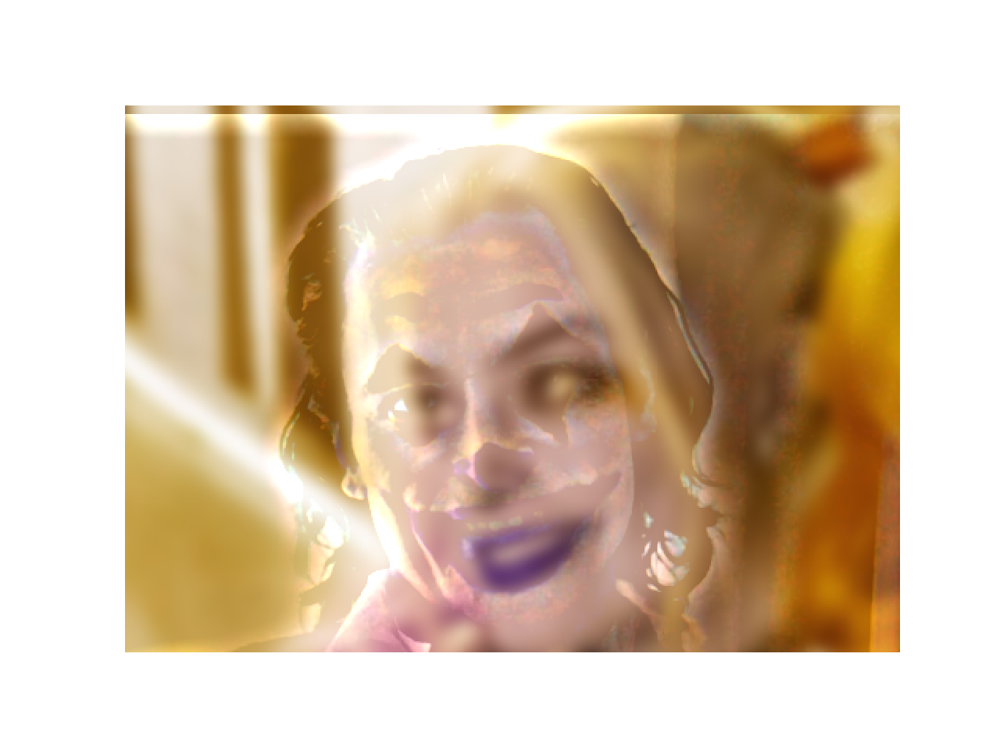

In [68]:
cropped_object = utils.interactive_crop(quinnjoker)

#### Color for Low Frequency

In [69]:
extraFile3 = './HarleyQuinnPortrait.jpg'
extraFile4 = './Joker_Headshot.jpg'
extra3 = cv2.imread(extraFile3, cv2.IMREAD_GRAYSCALE) #Setup for gray high pass
extra4 = cv2.imread(extraFile4)
extra4 = cv2.cvtColor(extra4, cv2.COLOR_BGR2RGB) #Set up for color low pass

<IPython.core.display.Javascript object>


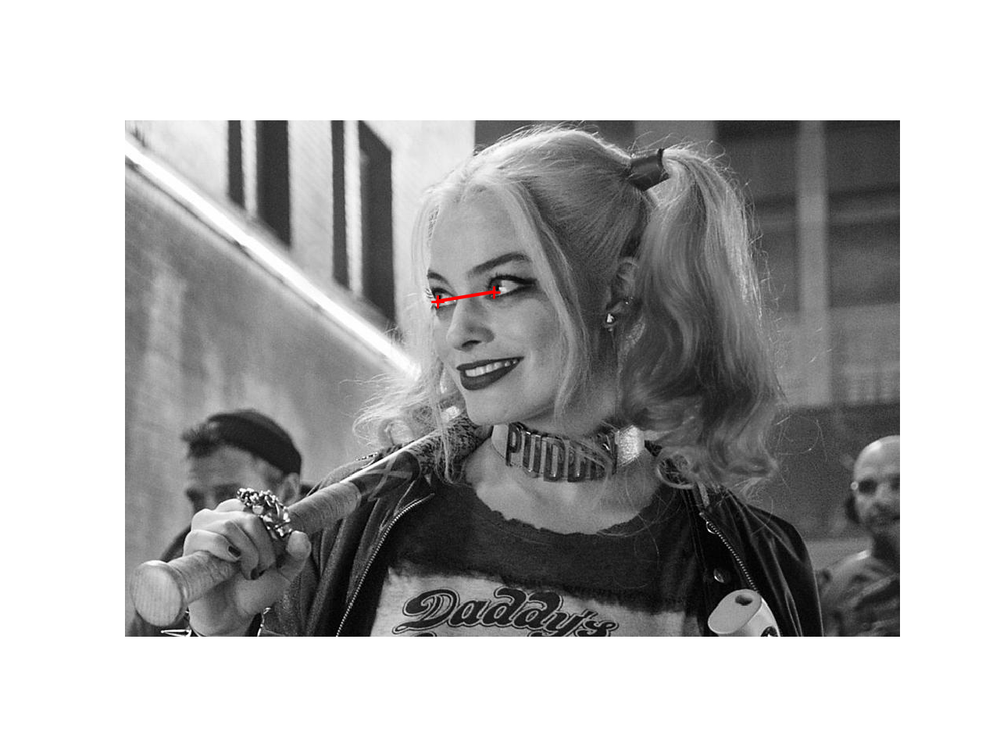

In [70]:
pts_extra3 = utils.prompt_eye_selection(extra3)

<IPython.core.display.Javascript object>


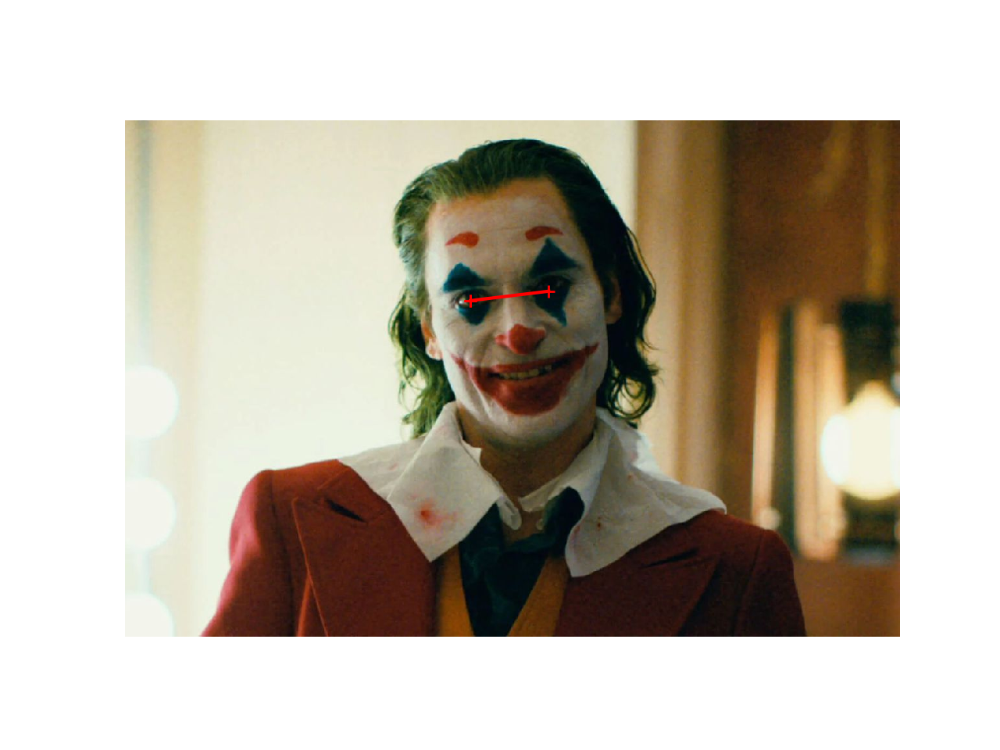

In [71]:
pts_extra4 = utils.prompt_eye_selection(extra4)

In [72]:
extra3, extra4 = utils.align_images(extraFile3, extraFile4,pts_extra3,pts_extra4,save_images=False)
# convert to grayscale
# extra1 = cv2.cvtColor(extra1, cv2.COLOR_BGR2GRAY) / 255.0
# extra3 = cv2.cvtColor(extra1, cv2.COLOR_BGR2RGB)
# extra4 = cv2.cvtColor(extra2, cv2.COLOR_BGR2GRAY) / 255.0

In [73]:
#Images sanity check
# fig, axes = plt.subplots(1, 2)
# axes[0].imshow(extra3, cmap='gray')
# axes[0].set_title('Image 1'), axes[0].set_xticks([]), axes[0].set_yticks([])
# axes[1].imshow(extra4)
# axes[1].set_title('Image 2'), axes[1].set_xticks([]), axes[1].set_yticks([]);

In [74]:
cutoff_low = 5
cutoff_high = 15
# Image Sanity Check
# lowPassImage = cv2.GaussianBlur(extra1, (35,35), cutoff_low)
# lowPassImage2 = cv2.GaussianBlur(extra2, (35,35), cutoff_high)
# highPassImage = cv2.subtract(extra2, lowPassImage2)
# fig, axes = plt.subplots(1, 2)
# axes[0].imshow(lowPassImage,cmap='gray')
# axes[0].set_title('Sample Image - Low Pass'), axes[0].set_xticks([]), axes[0].set_yticks([])
# axes[1].imshow(highPassImage,cmap='gray')
# axes[1].set_title('Sample Image - High Pass'), axes[1].set_xticks([]), axes[1].set_yticks([]);

quinnjoker3 = hybridImage(extra4, extra3, cutoff_low, cutoff_high)

<IPython.core.display.Javascript object>


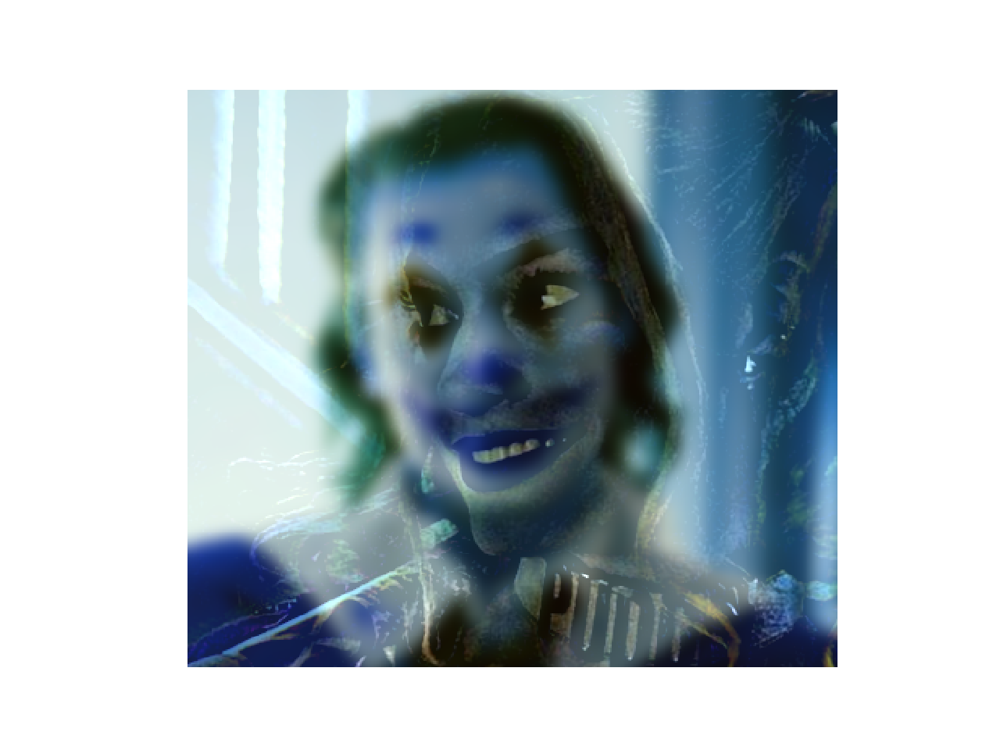

In [75]:
cropped_object = utils.interactive_crop(quinnjoker3)

#### Color on Both

In [76]:
extraFile5 = './HarleyQuinnPortrait.jpg'
extraFile6 = './Joker_Headshot.jpg'
extra5 = cv2.imread(extraFile5)
extra5 = cv2.cvtColor(extra5, cv2.COLOR_BGR2RGB)
extra6 = cv2.imread(extraFile6)
extra6 = cv2.cvtColor(extra6, cv2.COLOR_BGR2RGB)

<IPython.core.display.Javascript object>


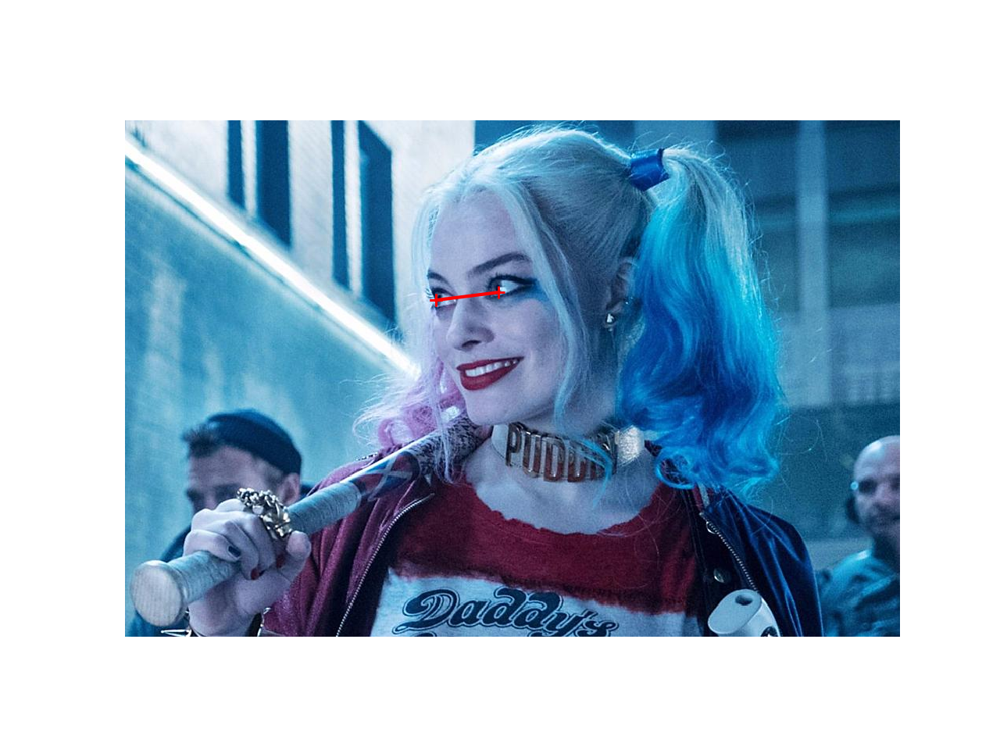

In [77]:
pts_extra5 = utils.prompt_eye_selection(extra5)

<IPython.core.display.Javascript object>


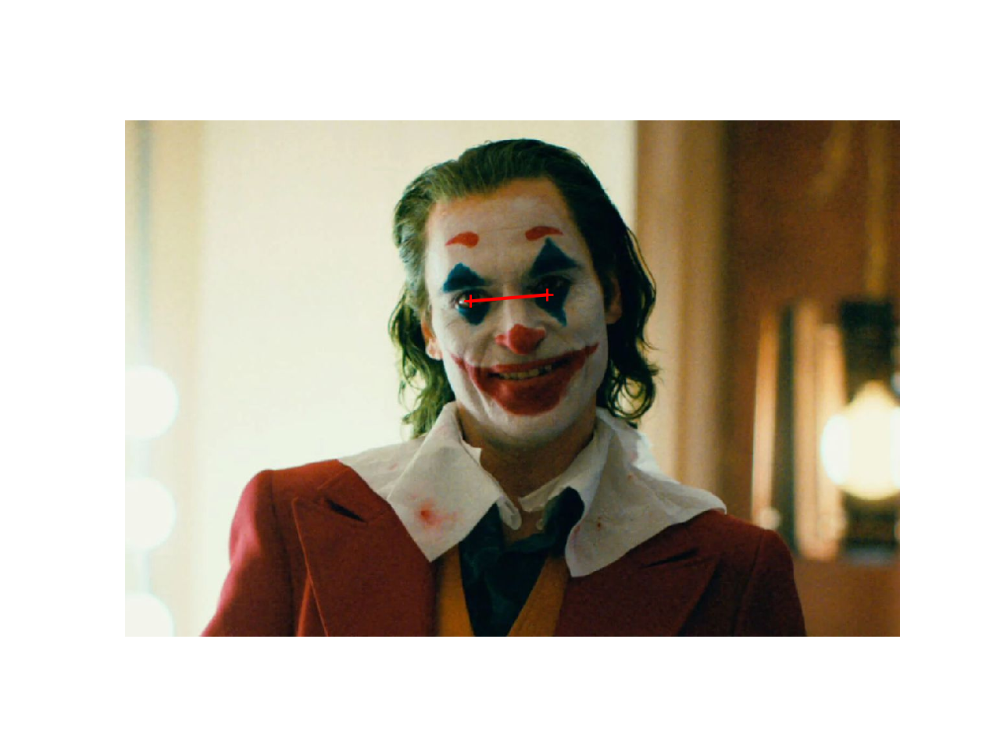

In [78]:
pts_extra6 = utils.prompt_eye_selection(extra6)

In [79]:
extra5, extra6 = utils.align_images(extraFile5, extraFile6,pts_extra5,pts_extra6,save_images=False)
# convert to grayscale
# extra1 = cv2.cvtColor(extra1, cv2.COLOR_BGR2GRAY) / 255.0
# extra3 = cv2.cvtColor(extra1, cv2.COLOR_BGR2RGB)
# extra4 = cv2.cvtColor(extra2, cv2.COLOR_BGR2GRAY) / 255.0

In [80]:
#Images sanity check
# fig, axes = plt.subplots(1, 2)
# axes[0].imshow(extra3, cmap='gray')
# axes[0].set_title('Image 1'), axes[0].set_xticks([]), axes[0].set_yticks([])
# axes[1].imshow(extra4)
# axes[1].set_title('Image 2'), axes[1].set_xticks([]), axes[1].set_yticks([]);

In [81]:
cutoff_low = 5
cutoff_high = 15
# Image Sanity Check
# lowPassImage = cv2.GaussianBlur(extra1, (35,35), cutoff_low)
# lowPassImage2 = cv2.GaussianBlur(extra2, (35,35), cutoff_high)
# highPassImage = cv2.subtract(extra2, lowPassImage2)
# fig, axes = plt.subplots(1, 2)
# axes[0].imshow(lowPassImage,cmap='gray')
# axes[0].set_title('Sample Image - Low Pass'), axes[0].set_xticks([]), axes[0].set_yticks([])
# axes[1].imshow(highPassImage,cmap='gray')
# axes[1].set_title('Sample Image - High Pass'), axes[1].set_xticks([]), axes[1].set_yticks([]);

quinnjoker4 = hybridImage(extra5, extra6, cutoff_low, cutoff_high)

<IPython.core.display.Javascript object>


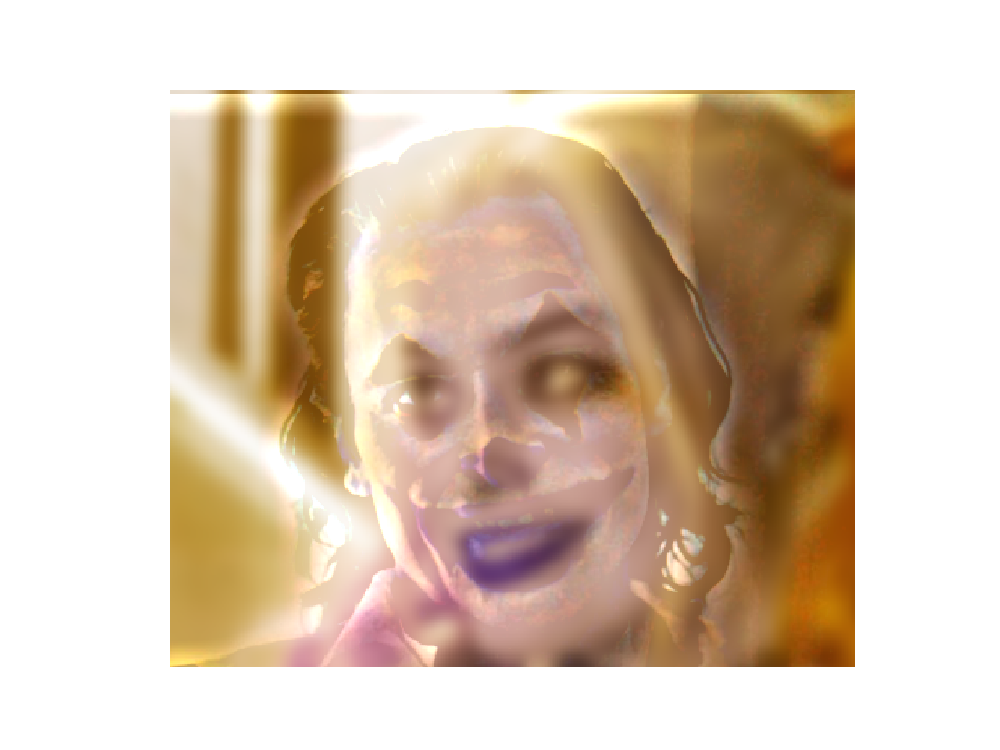

In [82]:
cropped_object = utils.interactive_crop(quinnjoker4)

#### Gaussian and Laplacian pyramids

#### All 3 Image Enhancements

See above